<a href="https://colab.research.google.com/github/desuhouro/NTHU_2023_DLBOI_HW/blob/main/hw2_report_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Lab 2: Build an ANN for Chest X-ray Image Classification


## Introduction

Pneumonia is a prevalent lung infection, and its early detection is paramount to ensure prompt and suitable treatment. In this tutorial, we'll leverage PyTorch, a leading deep learning framework, to construct a classifier using a chest X-ray dataset that distinguishes whether a patient is diagnosed with pneumonia. This dataset encompasses two distinct classes, with each class housing 1,000 grayscale images.

By the culmination of this tutorial, you'll have the prowess to:
- Preprocess and load the dataset.
- Build and train a classifier utilizing PyTorch.
- Evaluate your developed model.

For a deeper dive into PyTorch and its functionalities, consider exploring the [official PyTorch website](https://pytorch.org/).

### References

- [Chest X-ray Pneumonia Dataset from Kaggle](https://www.kaggle.com/datasets/paultimothymooney/chest-xray-pneumonia?resource=download)


In [ ]:
# Check your GPU status.
!nvidia-smi

Sun Oct 15 10:11:34 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
# Download dataset
!wget https://raw.githubusercontent.com/TacoXDD/homeworks/master/dataset/train/normal.npy
!wget https://raw.githubusercontent.com/TacoXDD/homeworks/master/dataset/train/pneumonia.npy

--2023-10-15 11:38:35--  https://raw.githubusercontent.com/TacoXDD/homeworks/master/dataset/train/normal.npy
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 65536128 (62M) [application/octet-stream]
Saving to: ‘normal.npy’

normal.npy          100%[===================>]  62.50M   213MB/s    in 0.3s    

2023-10-15 11:38:36 (213 MB/s) - ‘normal.npy’ saved [65536128/65536128]

--2023-10-15 11:38:36--  https://raw.githubusercontent.com/TacoXDD/homeworks/master/dataset/train/pneumonia.npy
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length

## A. Data Loading and Preprocessing

In this section, we'll go through the steps to load and preprocess the Chest X-ray dataset:

1. **Import Necessary Libraries**: We begin by importing the required Python modules such as `torch` and `numpy`.

2. **Load the Dataset**: The datasets for abnormal (indicative of pneumonia) and normal scans are loaded from their respective `.npy` files.

3. **Label Assignment**: For the purpose of binary classification:
   - Scans indicating the presence of pneumonia are labeled as `1`.
   - Scans that are normal are labeled as `0`.

4. **Data Splitting**: The dataset is then divided into training and validation sets, using a predefined `split_point` of 800.

5. **Conversion to PyTorch Tensors**: The numpy arrays of the images and labels are converted to PyTorch tensors to facilitate GPU-accelerated computations in the next steps.

6. **Dataset and DataLoader Creation**: Using PyTorch's `TensorDataset` and `DataLoader` utilities, we create datasets and data loaders for both training and validation data. This aids in easy batch processing and shuffling of the data during training.

In [ ]:
import torch
from torch.utils.data import DataLoader, TensorDataset, random_split

import numpy as np

# Load Dataset
abnormal_scans = np.load('pneumonia.npy')
normal_scans = np.load('normal.npy')

print(f'Shape of abnormal_scans: {abnormal_scans.shape}')
print(f'Shape of normal_scans: {normal_scans.shape}')

# For the data having presence of pneumonia
# assign 1, for the normal ones assign 0.
abnormal_labels = np.array([1 for _ in range(len(abnormal_scans))])
normal_labels = np.array([0 for _ in range(len(normal_scans))])

split_point = 800

x_train = np.concatenate((abnormal_scans[:split_point], normal_scans[:split_point]), axis=0)
y_train = np.concatenate((abnormal_labels[:split_point], normal_labels[:split_point]), axis=0)
x_val = np.concatenate((abnormal_scans[split_point:], normal_scans[split_point:]), axis=0)
y_val = np.concatenate((abnormal_labels[split_point:], normal_labels[split_point:]), axis=0)

# Convert to PyTorch tensors
x_train = torch.from_numpy(x_train).float()
y_train = torch.from_numpy(y_train).long()
x_val = torch.from_numpy(x_val).float()
y_val = torch.from_numpy(y_val).long()

# Create datasets
train_dataset = TensorDataset(x_train, y_train)
val_dataset = TensorDataset(x_val, y_val)

# Create dataloaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

print(f'Number of samples in train and validation are {len(train_loader.dataset)} and {len(val_loader.dataset)}.')
print(f'X_train: max value is {x_train.max().item()}, min value is {x_train.min().item()}, data type is {x_train.dtype}.')

Shape of abnormal_scans: (1000, 256, 256)
Shape of normal_scans: (1000, 256, 256)
Number of samples in train and validation are 1600 and 400.
X_train: max value is 255.0, min value is 0.0, data type is torch.float32.


Size of the image is: torch.Size([256, 256])


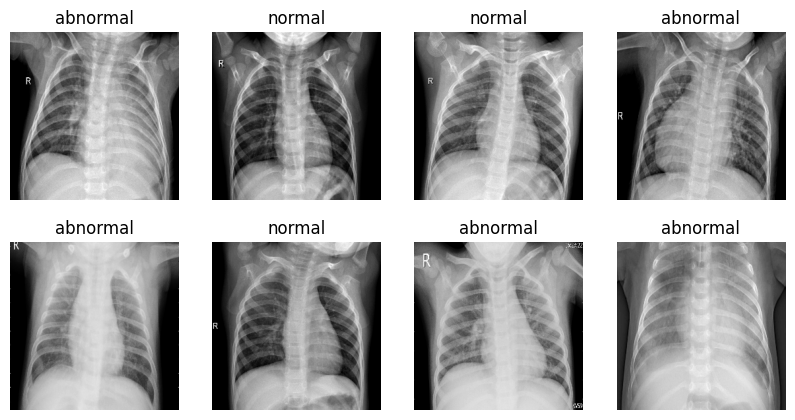

In [ ]:
# Check images

import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))
for images, labels in train_loader:
    print("Size of the image is:", images[0].shape)
    for i in range(8):
        ax = plt.subplot(2, 4, i + 1)
        plt.title(f"{'abnormal' if labels[i] else 'normal'}")
        plt.axis('off')
        plt.imshow(images[i], cmap='gray')
    break

## B. Defining Neural Networks in PyTorch

PyTorch offers the foundational module `torch.nn.Module` for designing neural networks. When it comes to defining a custom neural network, there are two primary approaches:

1. **Sequential Method**: Design your neural network as an ordered sequence of layers.
2. **Custom Class Method**: By extending `torch.nn.Module`, you can craft a network with more complex architectures and specific functionalities.

While the Sequential method is apt for standard networks where layers are stacked in order, the Custom Class method offers greater flexibility, allowing you to create intricate architectures.

### Common Layers in PyTorch:

* `Linear`: This represents a densely connected linear layer, similar to a single-layer perceptron.
* Activation Layers such as `Softmax`, `Sigmoid`, and `ReLU`: These layers introduce the needed non-linearity into the model.
* Additionally, PyTorch provides specialized layers tailored for specific architectures, including convolutional and recurrent layers, which we'll explore later in this course.

> **Note**: A unique feature of PyTorch is that many activation and loss functions are available in two forms: as **functions** (found in the `torch.nn.functional` namespace) and **as layers** (located in the `torch.nn` namespace). For activations, it's often more convenient to use the functional components from `torch.nn.functional` rather than instantiate separate layer objects.

In [ ]:
import torch.nn as nn
# torch.nn.functional
# Model definition
# model = nn.Sequential(
#     nn.Flatten(),
#     nn.Linear(256*256*1, 256),
#     nn.ReLU(),
#     nn.Linear(256, 1)#現在用的是binary cross entropy(兩個數log相加)第二個數字為loss用的數字，cross entropy要寫成2，會給兩類的propobility
# ).cuda()#cuda放進GPU裡面

print(model)

model = nn.Sequential(
    nn.Flatten(),

    nn.Linear(256*256*1, 64),
    nn.BatchNorm1d(64),
    nn.ReLU(),
    nn.Dropout(0.5),

    nn.Linear(64, 64),
    nn.BatchNorm1d(64),
    nn.ReLU(),
    nn.Dropout(0.5),

#     nn.Linear(64, 64),
#     nn.BatchNorm1d(64),
#     nn.ReLU(),
#     nn.Dropout(0.5),

    nn.Linear(64, 1)
).cuda()

print(model)

Sequential(
  (0): Flatten(start_dim=1, end_dim=-1)
  (1): Linear(in_features=65536, out_features=256, bias=True)
  (2): ReLU()
  (3): Linear(in_features=256, out_features=1, bias=True)
)
Sequential(
  (0): Flatten(start_dim=1, end_dim=-1)
  (1): Linear(in_features=65536, out_features=64, bias=True)
  (2): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (3): ReLU()
  (4): Dropout(p=0.5, inplace=False)
  (5): Linear(in_features=64, out_features=64, bias=True)
  (6): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): ReLU()
  (8): Dropout(p=0.5, inplace=False)
  (9): Linear(in_features=64, out_features=1, bias=True)
)


## C. Training the Neural Network (BCE)

In this section, we'll walk through the process of training and validating our neural network on the chest X-ray dataset. Here's a step-by-step breakdown:

1. **Setting Hyperparameters and Initialization**:
   - We'll be training our model for `30` epochs.
   - We initialize the `best_val_loss` as `infinity` to keep track of our best validation loss during training.

2. **Loss and Optimizer**:
   - We employ the `BCEWithLogitsLoss`, which is apt for binary classification tasks. This loss combines a sigmoid layer and the binary cross-entropy loss, making it more numerically stable than using them separately.
   - The optimizer of choice is `Adam`, with a learning rate of `1e-3`.
   - We'll also use a learning rate scheduler, `CosineAnnealingLR`, which adjusts the learning rate using a cosine annealing schedule.

3. **Training Loop**:
   - For each epoch, we put our model into training mode with `model.train()`.
   - We iterate over batches of data from our `train_loader`, sending the data to the GPU (with `.cuda()`), normalizing our images, and performing the forward and backward passes.
   - The gradients are then used to update the model's weights.

4. **Validation Loop**:
   - After training, we switch our model to evaluation mode using `model.eval()`.
   - We then evaluate our model's performance on the validation set. This involves forwarding our data through the model and computing the loss and accuracy.
   - The predictions are obtained by applying a threshold of `0.5` to the output sigmoid probabilities.

5. **Learning Rate Adjustment**:
   - After each epoch, we adjust the learning rate using our scheduler.

6. **Model Checkpointing**:
   - If our current model achieves a lower validation loss than our best recorded loss, we save this model as a checkpoint.

By the end of this training loop, we aim to have a trained model that performs well on our validation dataset, and we save the best-performing model to `model_classification.pth`.


In [ ]:
import torch.optim as optim
from torch.optim.lr_scheduler import CosineAnnealingLR

train_losses = []
val_losses = []
train_accuracies = []
val_accuracies = []

epochs = 30
best_val_loss = float('inf')

# Criterion and Optimizer(hyperparameter)
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-3)
lr_scheduler = CosineAnnealingLR(optimizer, T_max=len(train_loader)*epochs, eta_min=0)

for epoch in range(epochs):
    # Training
    model.train()
    total_loss = 0.0
    train_correct = 0
    total_train_samples = 0

    for images, labels in train_loader:
        images = images.cuda()
        images = images / 255.
        labels = labels.cuda()
        optimizer.zero_grad()
        outputs = model(images)
        labels = labels.float().unsqueeze(1)  # Convert labels to float and match shape with outputs
        loss = criterion(outputs, labels)
        loss.backward()#把loss gradient算回來
        optimizer.step()
        total_loss += loss.item()

        # Calculate correct predictions for training data
        train_predicted = torch.sigmoid(outputs) > 0.5
        train_correct += (train_predicted.float() == labels).sum().item()
        total_train_samples += labels.size(0)

    avg_train_loss = total_loss / len(train_loader)
    train_accuracy = 100. * train_correct / total_train_samples

    # Validation
    model.eval()
    total_val_loss = 0.0
    correct = 0
    total = 0
    with torch.no_grad():
        for images, labels in val_loader:
            images = images.cuda()
            images = images / 255.
            labels = labels.cuda()
            outputs = model(images)
            labels_float = labels.float().unsqueeze(1)  # Convert labels to float and match shape with outputs
            loss = criterion(outputs, labels_float)
            total_val_loss += loss.item()

            predicted = torch.sigmoid(outputs) > 0.5
            correct += (predicted.float() == labels_float).sum().item()
            total += labels.size(0)

    avg_val_loss = total_val_loss / len(val_loader)
    val_accuracy = 100. * correct / total

    print(f'Epoch {epoch+1}/{epochs}, Train Loss: {avg_train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%, Val Loss: {avg_val_loss:.4f}, Val Accuracy: {val_accuracy:.2f}%')

    # Learning rate update
    lr_scheduler.step()

    # Checkpoint
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        torch.save(model.state_dict(), 'model_classification.pth')

    # Store performance
    train_losses.append(avg_train_loss)
    train_accuracies.append(train_accuracy)
    val_losses.append(avg_val_loss)
    val_accuracies.append(val_accuracy)

Epoch 1/30, Train Loss: 0.2179, Train Accuracy: 91.38%, Val Loss: 0.2213, Val Accuracy: 92.25%
Epoch 2/30, Train Loss: 0.1588, Train Accuracy: 95.00%, Val Loss: 0.3085, Val Accuracy: 86.75%
Epoch 3/30, Train Loss: 0.1354, Train Accuracy: 95.25%, Val Loss: 0.3121, Val Accuracy: 86.75%
Epoch 4/30, Train Loss: 0.1135, Train Accuracy: 96.44%, Val Loss: 0.1477, Val Accuracy: 94.50%
Epoch 5/30, Train Loss: 0.1155, Train Accuracy: 95.81%, Val Loss: 0.2115, Val Accuracy: 92.25%
Epoch 6/30, Train Loss: 0.1052, Train Accuracy: 96.12%, Val Loss: 0.2540, Val Accuracy: 90.50%
Epoch 7/30, Train Loss: 0.0906, Train Accuracy: 96.81%, Val Loss: 0.2634, Val Accuracy: 91.00%
Epoch 8/30, Train Loss: 0.0869, Train Accuracy: 96.94%, Val Loss: 0.2573, Val Accuracy: 90.75%
Epoch 9/30, Train Loss: 0.1004, Train Accuracy: 96.38%, Val Loss: 0.1401, Val Accuracy: 94.75%
Epoch 10/30, Train Loss: 0.0800, Train Accuracy: 96.69%, Val Loss: 0.1431, Val Accuracy: 94.50%
Epoch 11/30, Train Loss: 0.0743, Train Accuracy: 

### Visualizing model performance

Here the model accuracy and loss for the training and the validation sets are plotted.

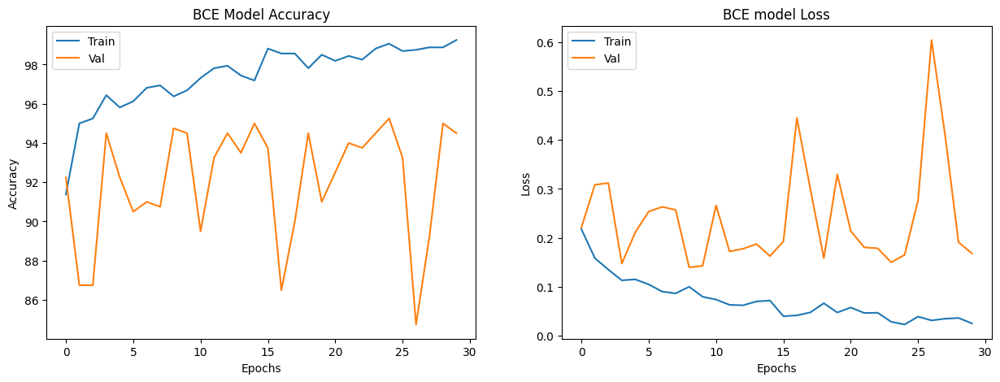

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 2, figsize=(15, 5))

# Plotting training and validation accuracy
ax[0].plot(train_accuracies)
ax[0].plot(val_accuracies)
ax[0].set_title("BCE Model Accuracy")
ax[0].set_xlabel("Epochs")
ax[0].set_ylabel("Accuracy")
ax[0].legend(["Train", "Val"])

# Plotting training and validation loss
ax[1].plot(train_losses)
ax[1].plot(val_losses)
ax[1].set_title("BCE model Loss")
ax[1].set_xlabel("Epochs")
ax[1].set_ylabel("Loss")
ax[1].legend(["Train", "Val"])

plt.show()

## D. Model Evaluation with a Test Image

In this section, we'll evaluate our trained model using a random test image from the validation set to understand its prediction capability.

1. **Loading the Best Model**: We begin by loading the best model saved during training using the `load_state_dict` function.

2. **Random Image Selection**: A random index is chosen from the validation dataset, which will be used to fetch the corresponding X-ray image.

3. **Image Normalization**: Just like during the training process, we normalize our test image to ensure consistent input data distribution for the model.

4. **Prediction**: We pass the normalized test image through the model to obtain its prediction. Since the output of our model is in logits, we apply the `sigmoid` function to convert these logits to probabilities for our two classes - "normal" and "abnormal".

5. **Output Interpretation**:
We determine the model's final prediction by selecting the class with the highest confidence score.

6. **Visualization**: Lastly, we display the test image using `imshow` to have a visual understanding of what the model sees. The ground truth label for this image is also shown in the title for reference.

By repeatedly executing this section, you can evaluate the model's performance on different test images from the validation set and gain insight into its strengths and potential areas of improvement.


In [ ]:
!wget https://raw.githubusercontent.com/TacoXDD/homeworks/master/dataset/test/test_normal.npy
!wget https://raw.githubusercontent.com/TacoXDD/homeworks/master/dataset/test/test_pneumonia.npy

--2023-10-15 12:10:34--  https://raw.githubusercontent.com/TacoXDD/homeworks/master/dataset/test/test_normal.npy
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13107328 (12M) [application/octet-stream]
Saving to: ‘test_normal.npy.4’

test_normal.npy.4   100%[===================>]  12.50M  --.-KB/s    in 0.1s    

2023-10-15 12:10:35 (121 MB/s) - ‘test_normal.npy.4’ saved [13107328/13107328]

--2023-10-15 12:10:35--  https://raw.githubusercontent.com/TacoXDD/homeworks/master/dataset/test/test_pneumonia.npy
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.108.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting res

In [ ]:
import numpy as np

test_abnormal = np.load('test_pneumonia.npy')
test_normal = np.load('test_normal.npy')

print(f'Shape of test_abnormal: {test_abnormal.shape}')
print(f'Shape of test_normal: {test_normal.shape}')

# For the data having presence of pneumonia assign 1, for the normal ones assign 0.
test_abnormal_labels = np.ones((test_abnormal.shape[0],))
test_normal_labels = np.zeros((test_normal.shape[0],))

x_test = np.concatenate((test_abnormal, test_normal), axis=0)
y_test = np.concatenate((test_abnormal_labels, test_normal_labels), axis=0)

print(f'Shape of x_test: {x_test.shape}')
print(f'Shape of y_test: {y_test.shape}')

import torch
from torch.utils.data import DataLoader, TensorDataset, random_split

# Convert to PyTorch tensors
x_test = torch.from_numpy(x_test).float()
y_test = torch.from_numpy(y_test).long()

# Combine the images and labels into a dataset
test_dataset = TensorDataset(x_test, y_test)

# Create a dataloader to load data in batches. Set batch size to 32.
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=True)

Shape of test_abnormal: (200, 256, 256)
Shape of test_normal: (200, 256, 256)
Shape of x_test: (400, 256, 256)
Shape of y_test: (400,)


Take # 205 as test image.
This model is 50.1% confident that the scan is abnormal and 49.9% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



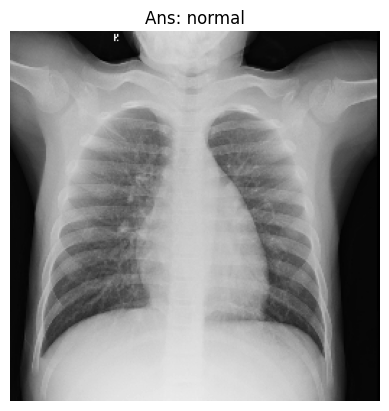

Take # 106 as test image.
This model is 71.74% confident that the scan is abnormal and 28.26% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



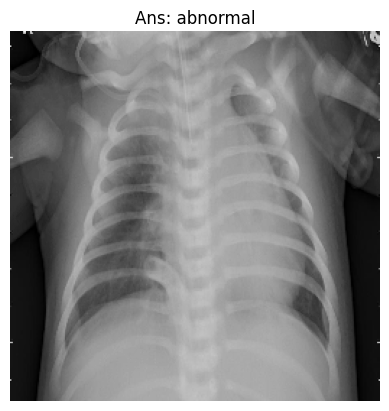

Take # 40 as test image.
This model is 73.03% confident that the scan is abnormal and 26.97% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



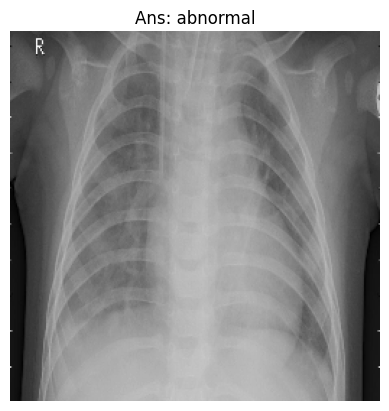

Take # 209 as test image.
This model is 50.89% confident that the scan is abnormal and 49.11% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



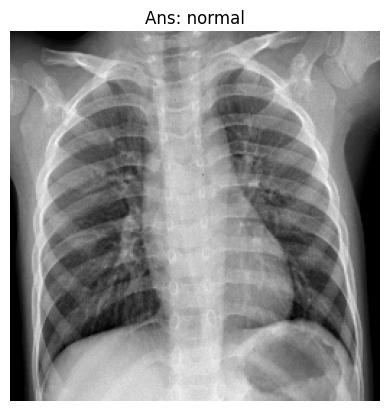

Take # 347 as test image.
This model is 55.71% confident that the scan is abnormal and 44.29% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



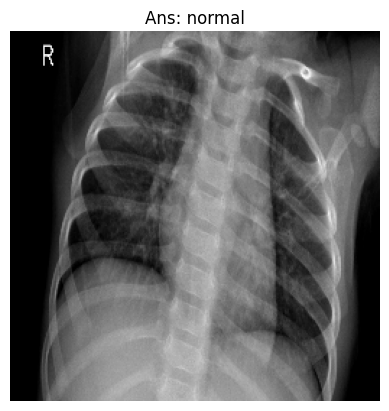

Take # 385 as test image.
This model is 50.43% confident that the scan is abnormal and 49.57% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



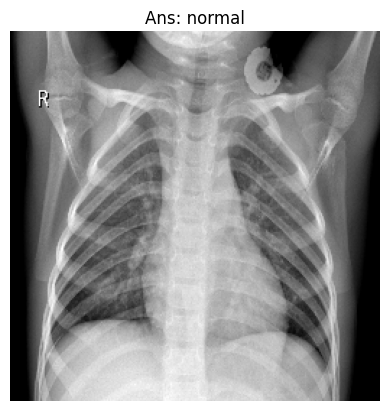

Take # 355 as test image.
This model is 50.09% confident that the scan is abnormal and 49.91% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



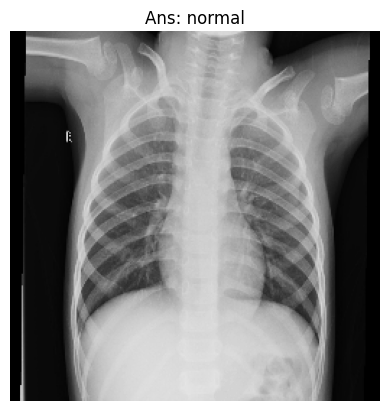

Take # 385 as test image.
This model is 50.43% confident that the scan is abnormal and 49.57% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



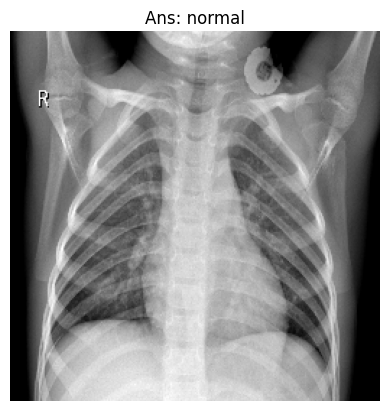

Take # 259 as test image.
This model is 53.51% confident that the scan is abnormal and 46.49% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



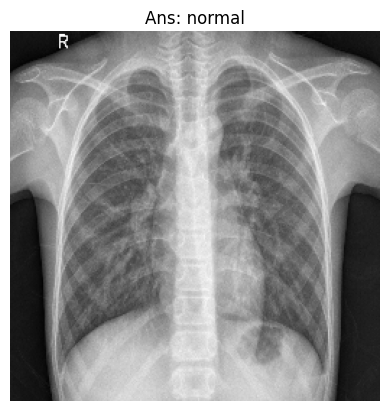

Take # 270 as test image.
This model is 52.16% confident that the scan is abnormal and 47.84% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



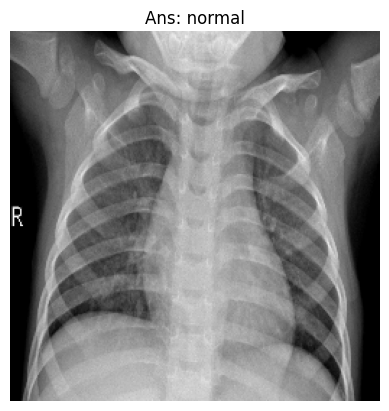

Take # 364 as test image.
This model is 67.25% confident that the scan is abnormal and 32.75% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



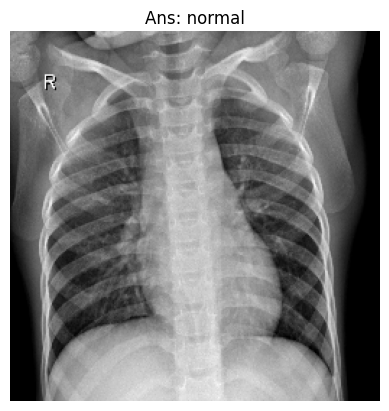

Take # 392 as test image.
This model is 73.03% confident that the scan is abnormal and 26.97% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



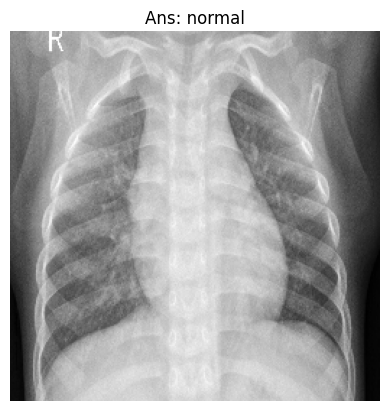

Take # 321 as test image.
This model is 50.95% confident that the scan is abnormal and 49.05% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



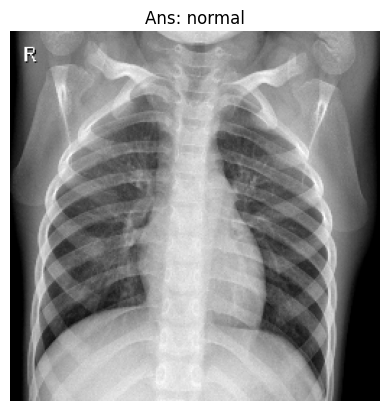

Take # 125 as test image.
This model is 72.43% confident that the scan is abnormal and 27.57% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



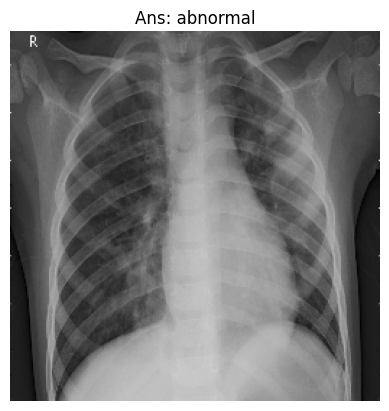

Take # 397 as test image.
This model is 50.31% confident that the scan is abnormal and 49.69% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



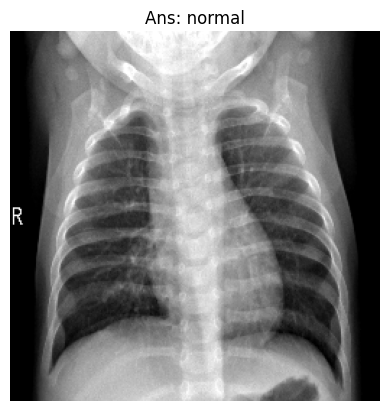

Take # 321 as test image.
This model is 50.95% confident that the scan is abnormal and 49.05% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



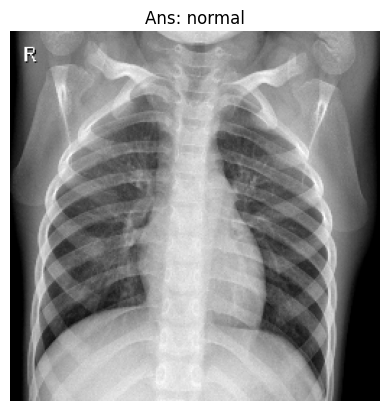

Take # 79 as test image.
This model is 73.08% confident that the scan is abnormal and 26.92% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



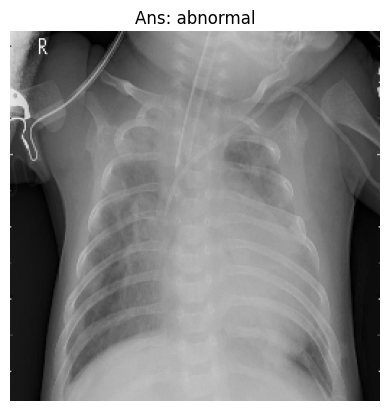

Take # 367 as test image.
This model is 73.06% confident that the scan is abnormal and 26.94% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



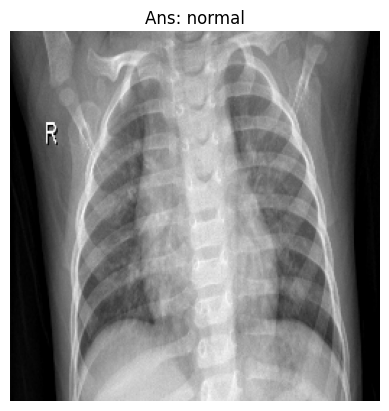

Take # 207 as test image.
This model is 54.22% confident that the scan is abnormal and 45.78% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



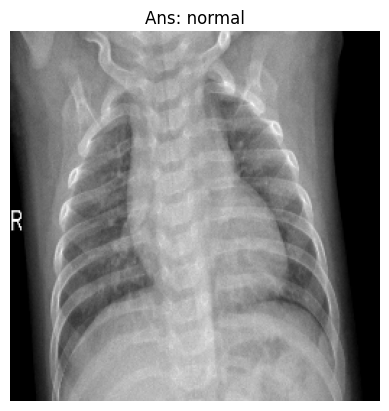

Take # 242 as test image.
This model is 52.38% confident that the scan is abnormal and 47.62% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



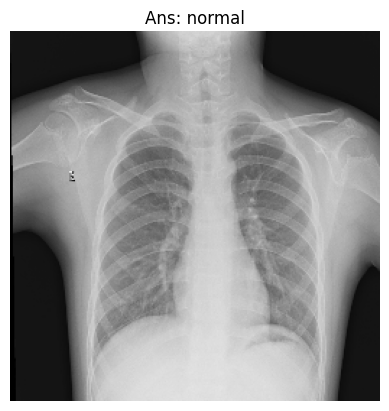

Take # 66 as test image.
This model is 73.08% confident that the scan is abnormal and 26.92% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



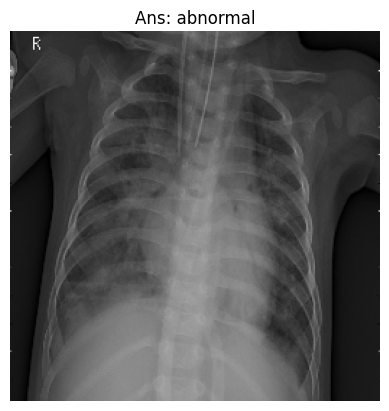

Take # 396 as test image.
This model is 52.13% confident that the scan is abnormal and 47.87% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



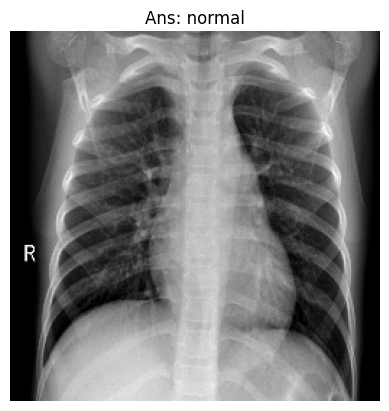

Take # 367 as test image.
This model is 73.06% confident that the scan is abnormal and 26.94% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



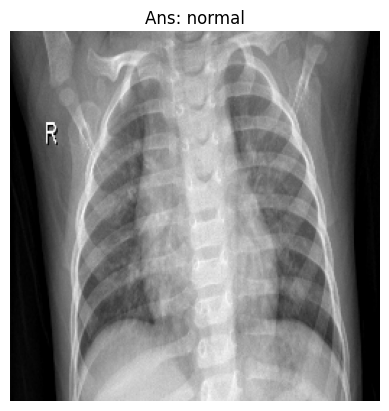

Take # 135 as test image.
This model is 73.1% confident that the scan is abnormal and 26.9% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



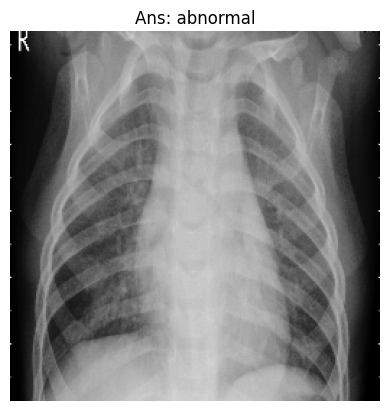

Take # 279 as test image.
This model is 54.52% confident that the scan is abnormal and 45.48% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



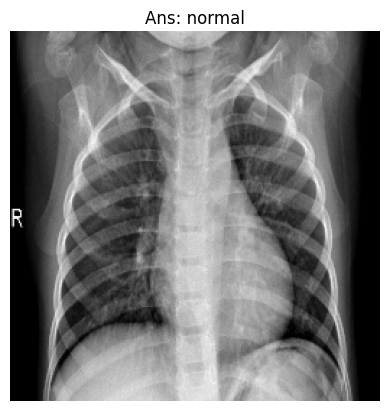

Take # 218 as test image.
This model is 71.69% confident that the scan is abnormal and 28.31% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



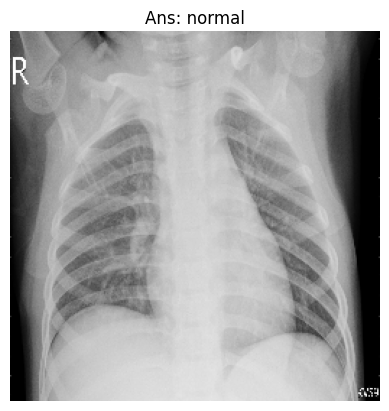

Take # 10 as test image.
This model is 72.07% confident that the scan is abnormal and 27.93% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



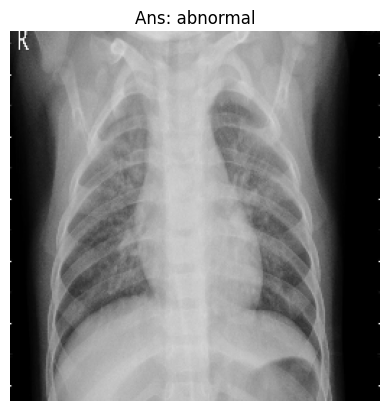

Take # 78 as test image.
This model is 72.49% confident that the scan is abnormal and 27.51% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



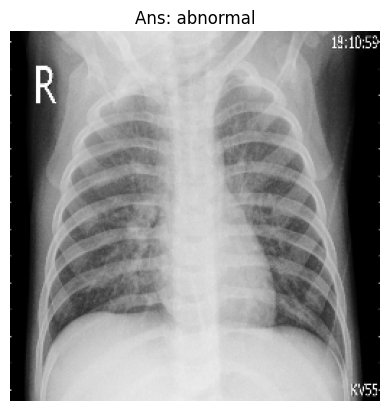

Take # 128 as test image.
This model is 73.08% confident that the scan is abnormal and 26.92% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



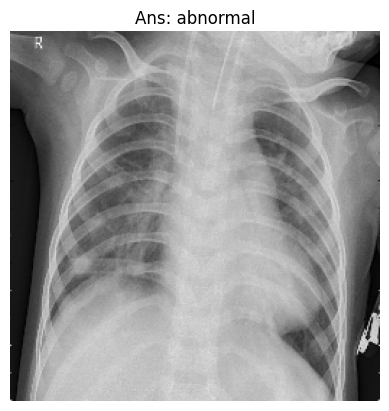

Take # 219 as test image.
This model is 57.66% confident that the scan is abnormal and 42.34% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



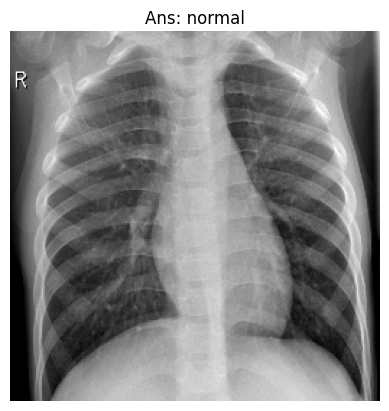

Take # 178 as test image.
This model is 72.55% confident that the scan is abnormal and 27.45% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



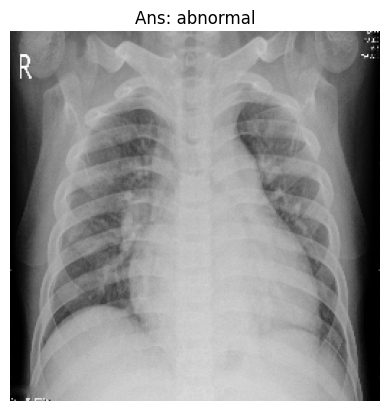

Take # 282 as test image.
This model is 50.21% confident that the scan is abnormal and 49.79% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



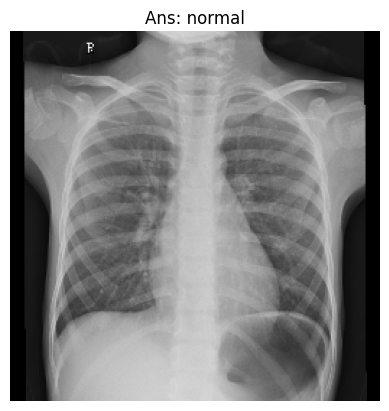

Take # 328 as test image.
This model is 60.03% confident that the scan is abnormal and 39.97% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



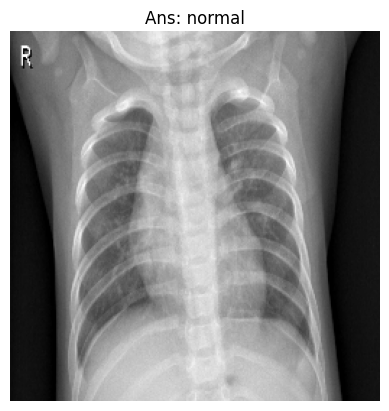

Take # 52 as test image.
This model is 73.06% confident that the scan is abnormal and 26.94% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



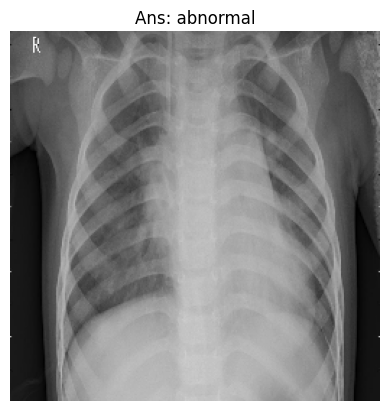

Take # 250 as test image.
This model is 62.17% confident that the scan is abnormal and 37.83% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



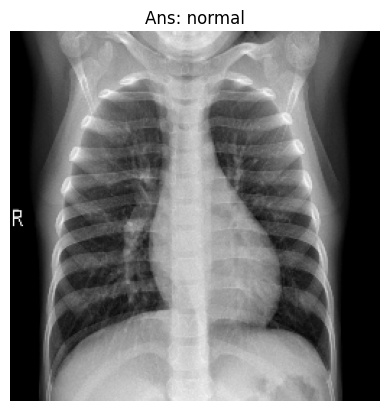

Take # 47 as test image.
This model is 73.08% confident that the scan is abnormal and 26.92% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



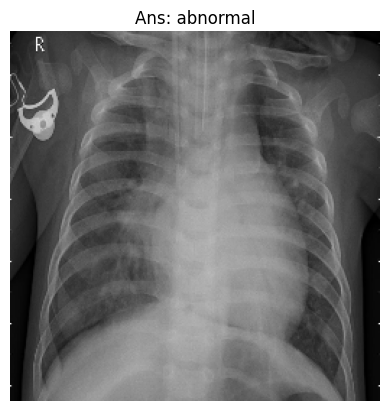

Take # 130 as test image.
This model is 73.1% confident that the scan is abnormal and 26.9% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



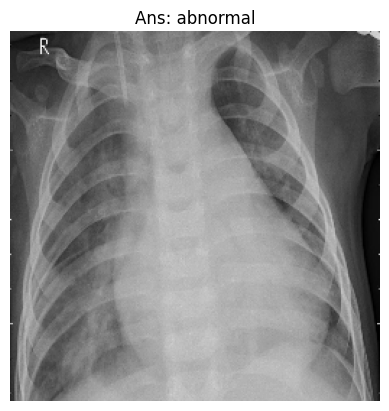

Take # 130 as test image.
This model is 73.1% confident that the scan is abnormal and 26.9% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



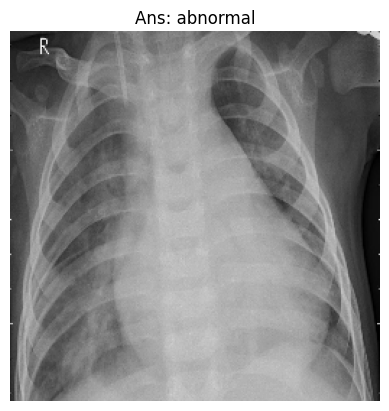

Take # 389 as test image.
This model is 72.96% confident that the scan is abnormal and 27.04% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



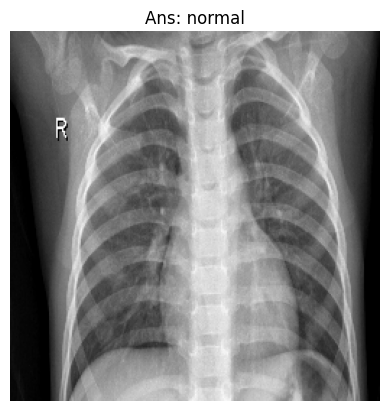

Take # 163 as test image.
This model is 57.2% confident that the scan is abnormal and 42.8% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



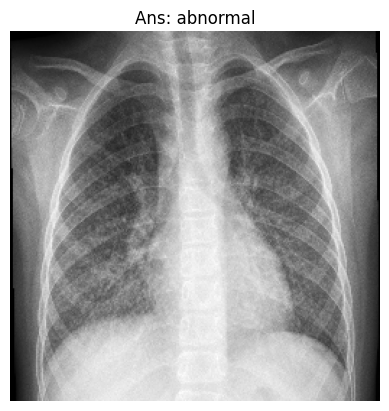

Take # 111 as test image.
This model is 72.85% confident that the scan is abnormal and 27.15% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



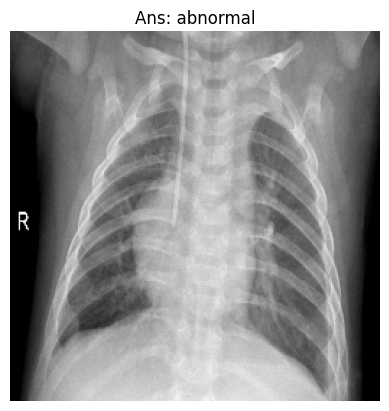

Take # 186 as test image.
This model is 73.07% confident that the scan is abnormal and 26.93% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



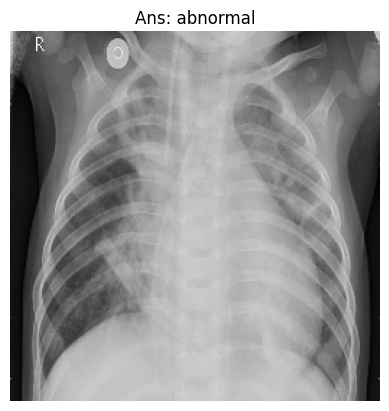

Take # 281 as test image.
This model is 50.01% confident that the scan is abnormal and 49.99% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



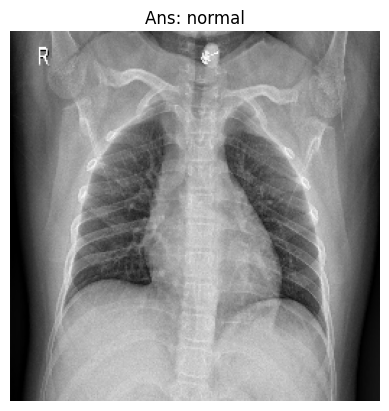

Take # 198 as test image.
This model is 73.08% confident that the scan is abnormal and 26.92% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



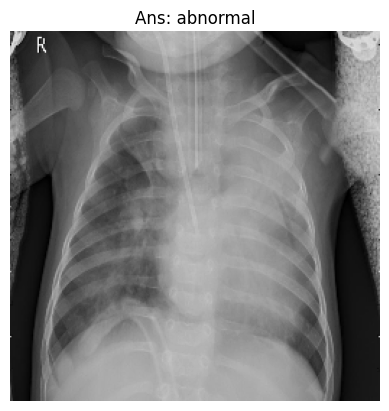

Take # 94 as test image.
This model is 70.32% confident that the scan is abnormal and 29.68% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



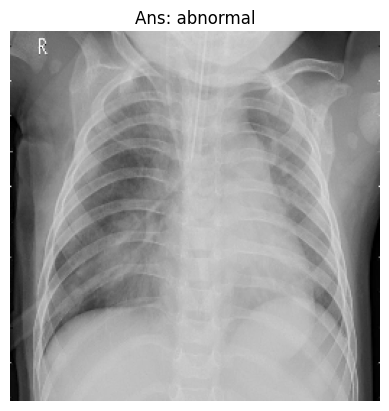

Take # 77 as test image.
This model is 72.39% confident that the scan is abnormal and 27.61% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



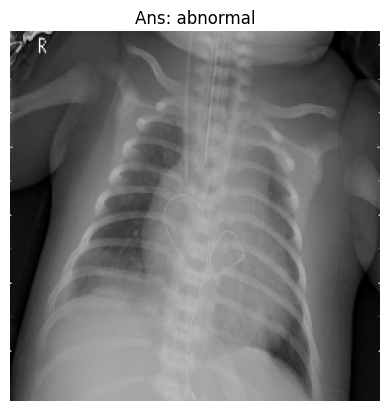

Take # 68 as test image.
This model is 72.81% confident that the scan is abnormal and 27.19% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



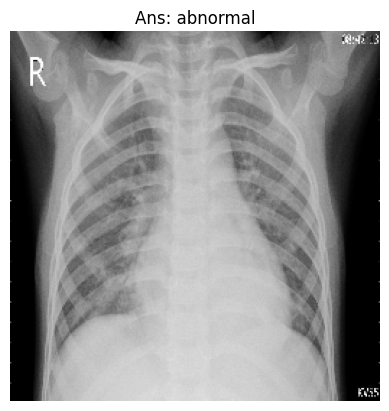

Take # 62 as test image.
This model is 72.19% confident that the scan is abnormal and 27.81% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



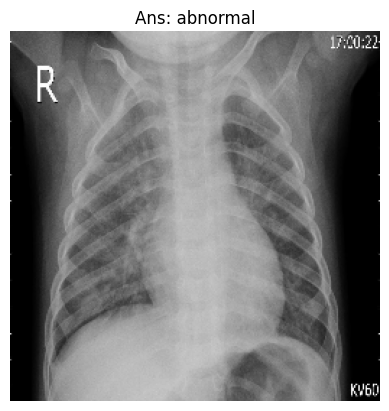

Take # 232 as test image.
This model is 62.15% confident that the scan is abnormal and 37.85% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



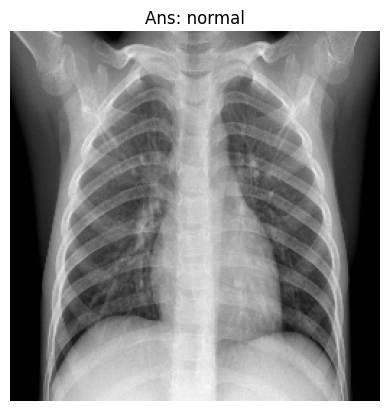

Take # 83 as test image.
This model is 51.91% confident that the scan is abnormal and 48.09% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



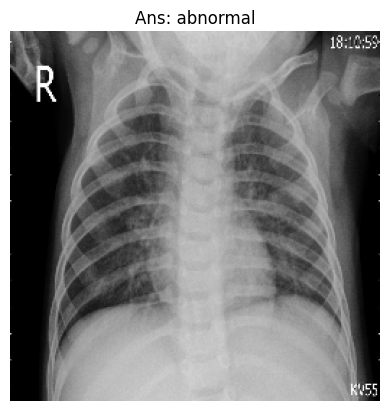

Take # 353 as test image.
This model is 52.77% confident that the scan is abnormal and 47.23% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



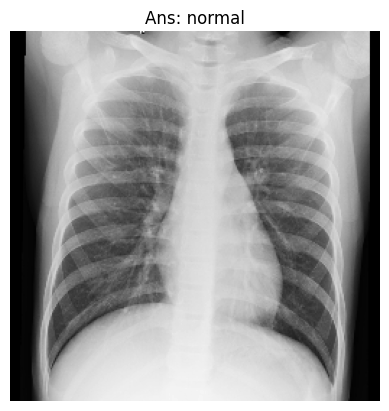

Take # 203 as test image.
This model is 50.09% confident that the scan is abnormal and 49.91% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



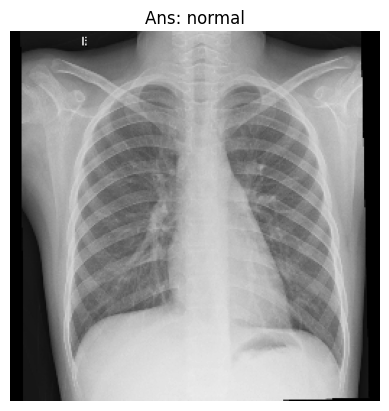

Take # 15 as test image.
This model is 73.07% confident that the scan is abnormal and 26.93% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



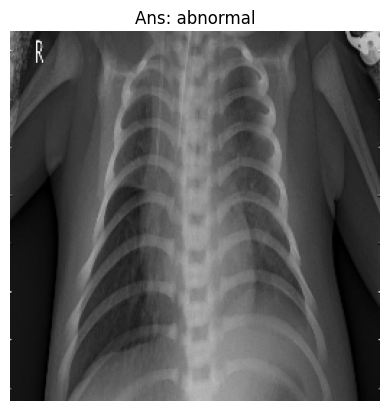

Take # 62 as test image.
This model is 72.19% confident that the scan is abnormal and 27.81% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



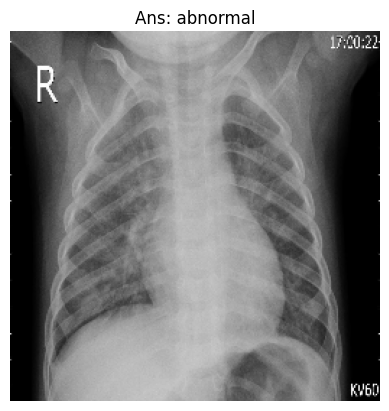

Take # 152 as test image.
This model is 73.11% confident that the scan is abnormal and 26.89% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



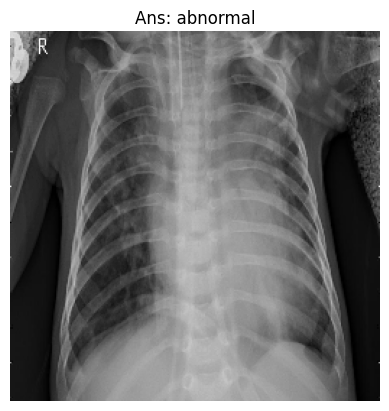

Take # 134 as test image.
This model is 68.73% confident that the scan is abnormal and 31.27% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



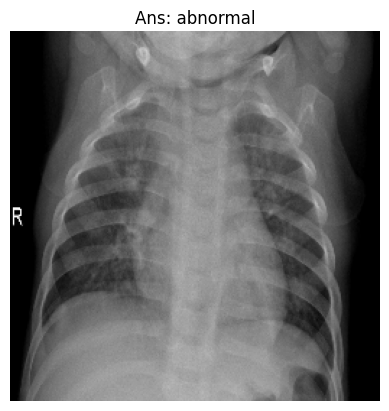

Take # 174 as test image.
This model is 73.0% confident that the scan is abnormal and 27.0% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



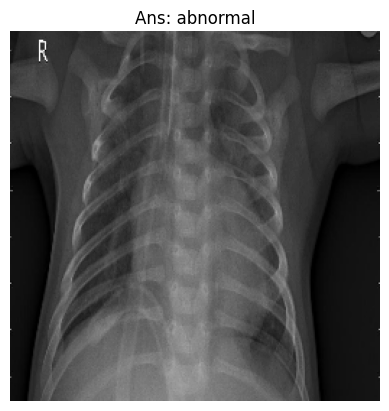

Take # 336 as test image.
This model is 71.31% confident that the scan is abnormal and 28.69% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



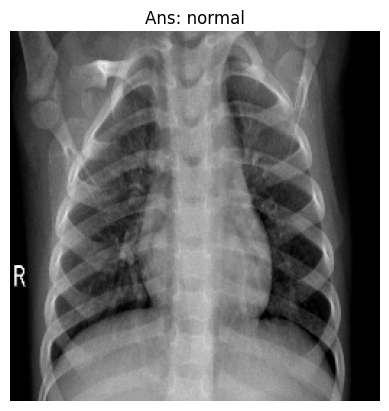

Take # 362 as test image.
This model is 53.86% confident that the scan is abnormal and 46.14% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



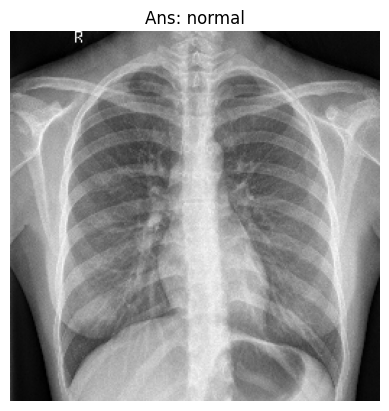

Take # 103 as test image.
This model is 72.96% confident that the scan is abnormal and 27.04% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



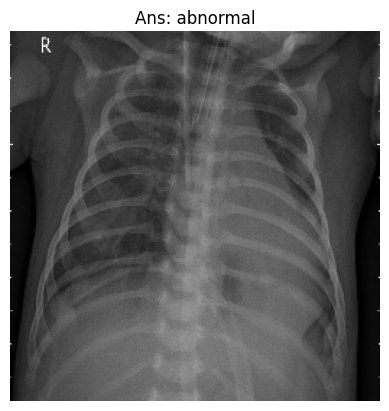

Take # 105 as test image.
This model is 70.87% confident that the scan is abnormal and 29.13% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



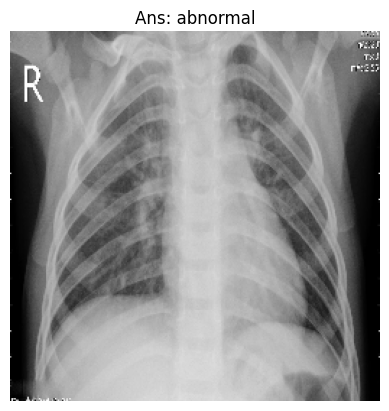

Take # 159 as test image.
This model is 73.09% confident that the scan is abnormal and 26.91% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



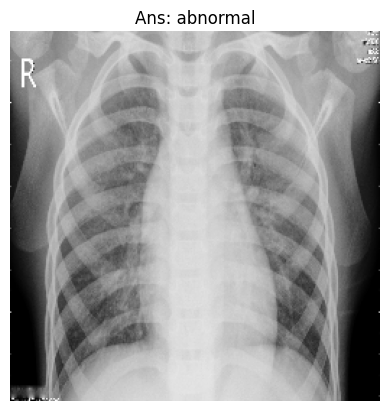

Take # 345 as test image.
This model is 50.02% confident that the scan is abnormal and 49.98% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



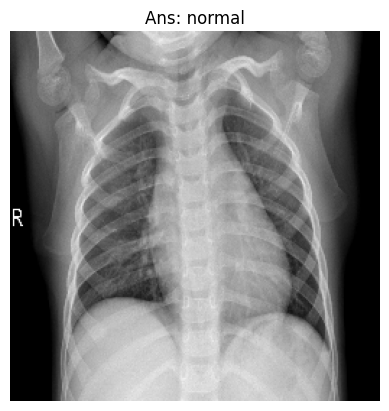

Take # 56 as test image.
This model is 73.07% confident that the scan is abnormal and 26.93% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



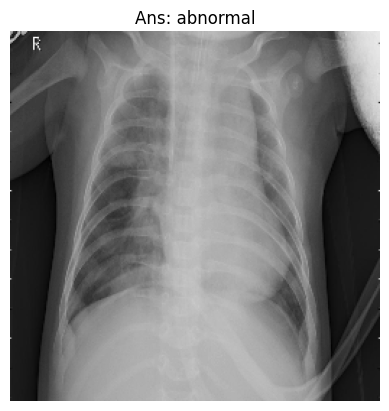

Take # 385 as test image.
This model is 50.43% confident that the scan is abnormal and 49.57% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



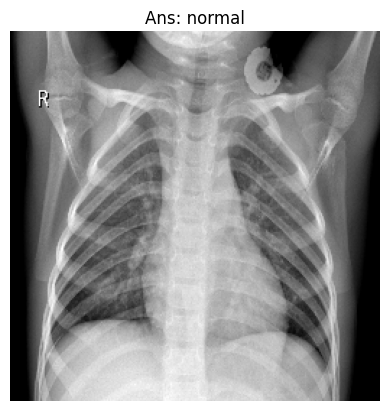

Take # 137 as test image.
This model is 73.08% confident that the scan is abnormal and 26.92% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



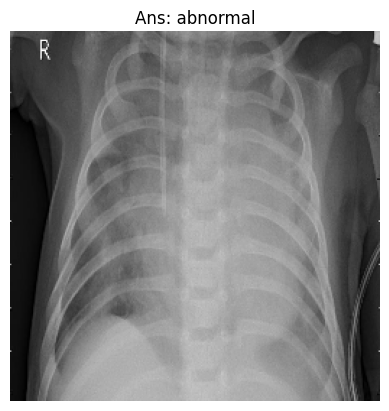

Take # 233 as test image.
This model is 68.6% confident that the scan is abnormal and 31.4% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



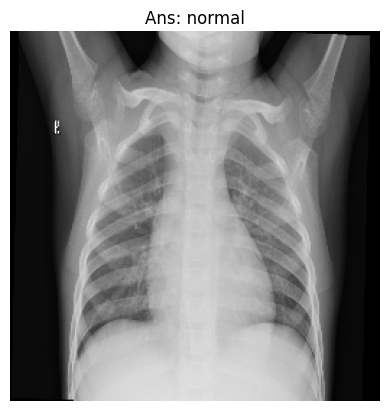

Take # 332 as test image.
This model is 72.98% confident that the scan is abnormal and 27.02% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



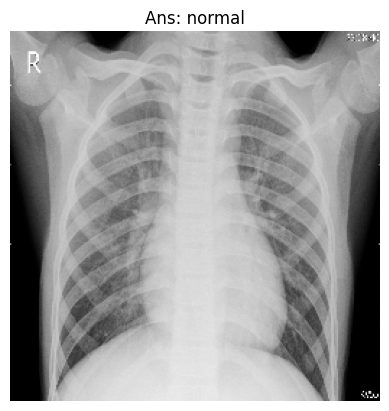

Take # 333 as test image.
This model is 51.76% confident that the scan is abnormal and 48.24% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



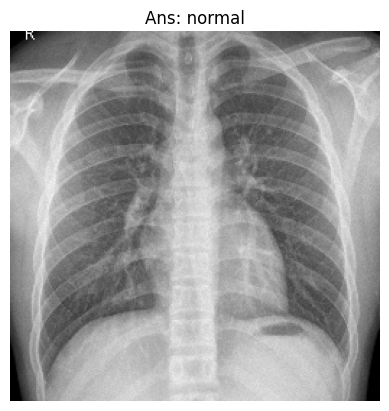

Take # 219 as test image.
This model is 57.66% confident that the scan is abnormal and 42.34% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



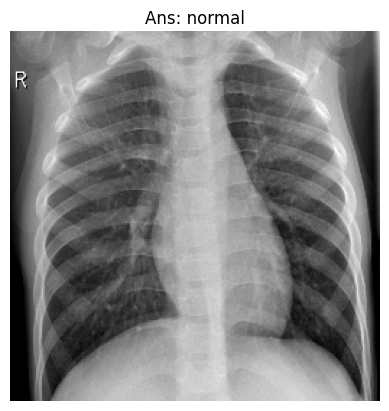

Take # 265 as test image.
This model is 53.2% confident that the scan is abnormal and 46.8% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



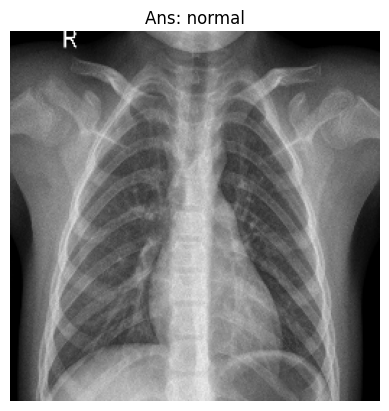

Take # 383 as test image.
This model is 52.27% confident that the scan is abnormal and 47.73% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



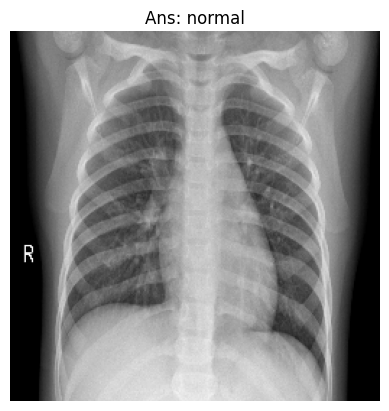

Take # 398 as test image.
This model is 50.03% confident that the scan is abnormal and 49.97% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



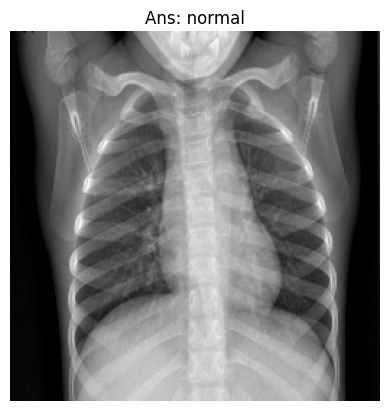

Take # 207 as test image.
This model is 54.22% confident that the scan is abnormal and 45.78% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



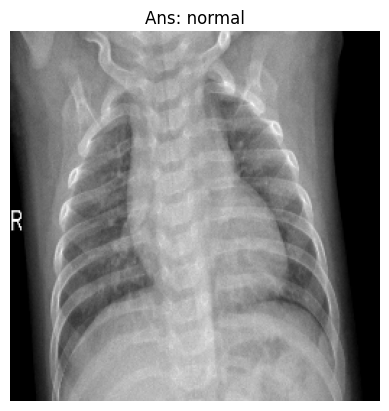

Take # 105 as test image.
This model is 70.87% confident that the scan is abnormal and 29.13% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



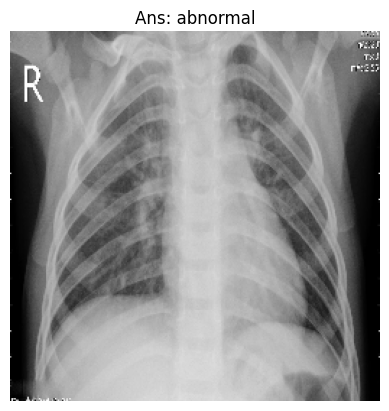

Take # 352 as test image.
This model is 52.51% confident that the scan is abnormal and 47.49% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



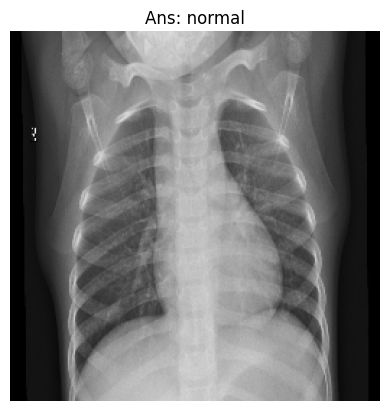

Take # 73 as test image.
This model is 73.1% confident that the scan is abnormal and 26.9% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



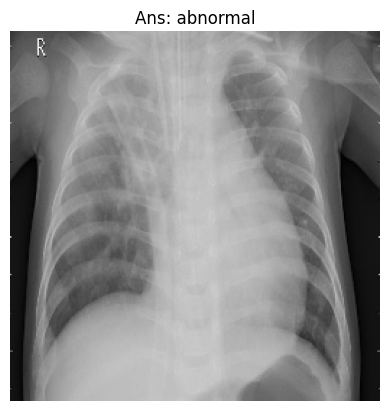

Take # 314 as test image.
This model is 50.05% confident that the scan is abnormal and 49.95% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



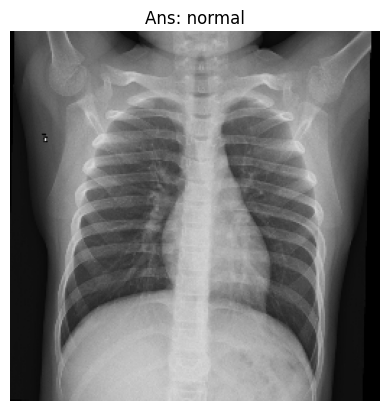

Take # 170 as test image.
This model is 68.77% confident that the scan is abnormal and 31.23% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



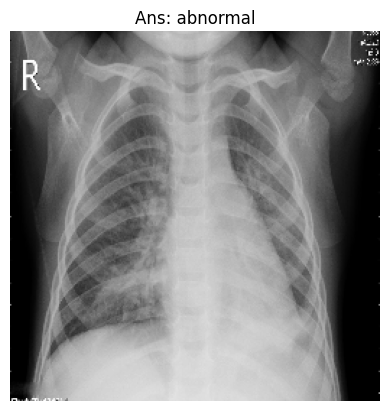

Take # 101 as test image.
This model is 72.95% confident that the scan is abnormal and 27.05% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



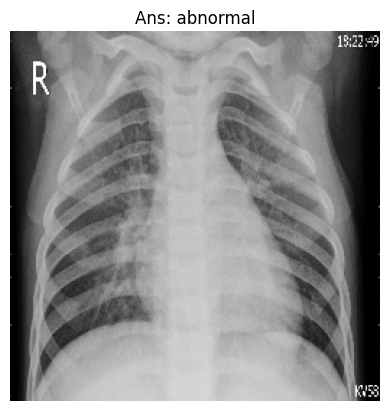

Take # 371 as test image.
This model is 50.23% confident that the scan is abnormal and 49.77% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



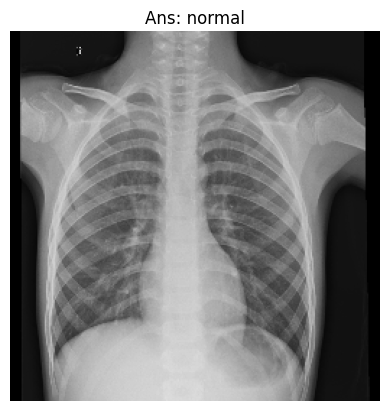

Take # 354 as test image.
This model is 72.73% confident that the scan is abnormal and 27.27% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



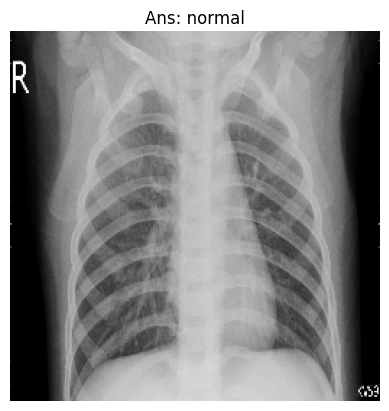

Take # 395 as test image.
This model is 69.49% confident that the scan is abnormal and 30.51% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



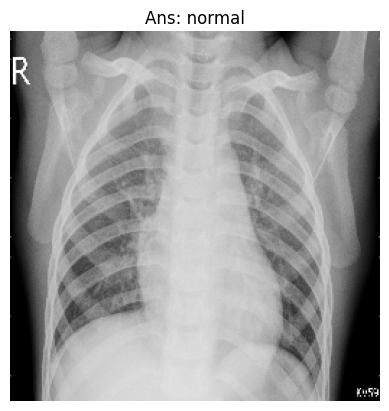

Take # 138 as test image.
This model is 73.07% confident that the scan is abnormal and 26.93% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



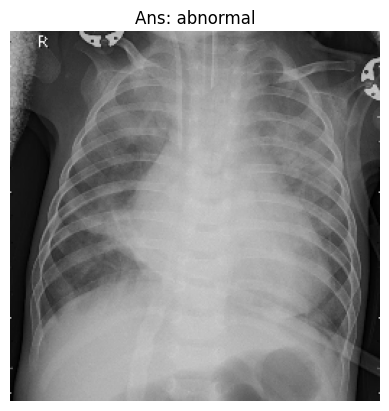

Take # 337 as test image.
This model is 51.16% confident that the scan is abnormal and 48.84% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



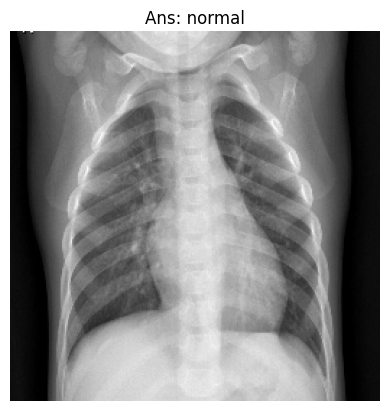

Take # 324 as test image.
This model is 63.56% confident that the scan is abnormal and 36.44% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



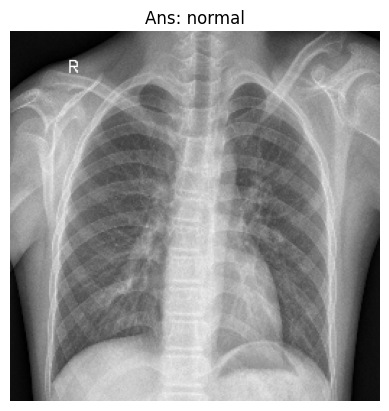

Take # 66 as test image.
This model is 73.08% confident that the scan is abnormal and 26.92% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



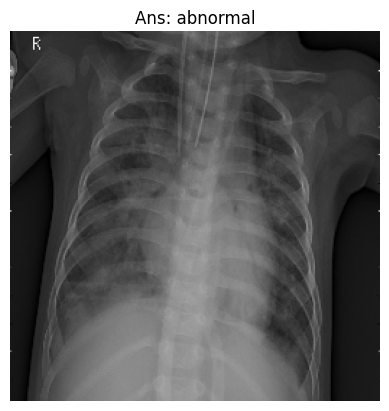

Take # 95 as test image.
This model is 72.79% confident that the scan is abnormal and 27.21% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



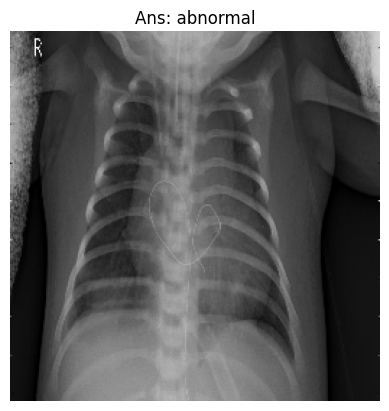

Take # 190 as test image.
This model is 73.1% confident that the scan is abnormal and 26.9% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



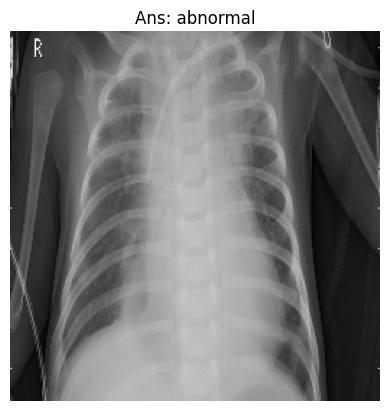

Take # 60 as test image.
This model is 73.1% confident that the scan is abnormal and 26.9% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



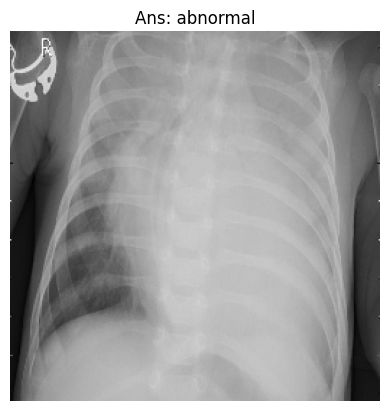

Take # 153 as test image.
This model is 71.17% confident that the scan is abnormal and 28.83% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



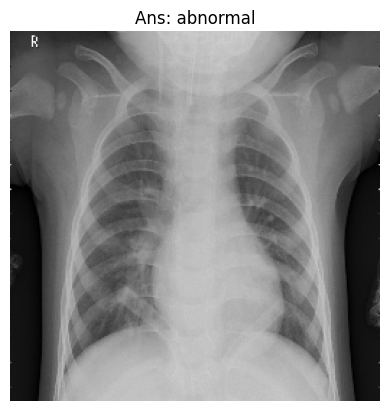

Take # 68 as test image.
This model is 72.81% confident that the scan is abnormal and 27.19% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



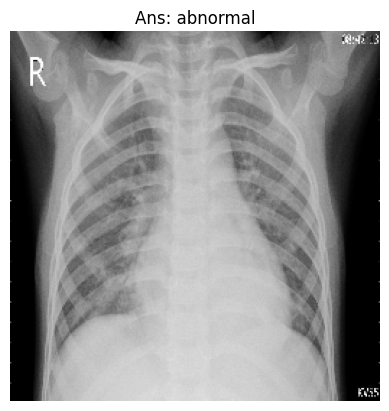

Take # 88 as test image.
This model is 72.97% confident that the scan is abnormal and 27.03% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



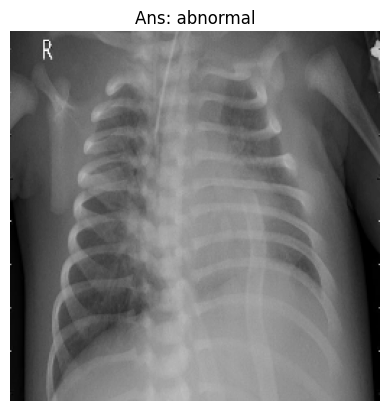

Take # 133 as test image.
This model is 72.51% confident that the scan is abnormal and 27.49% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



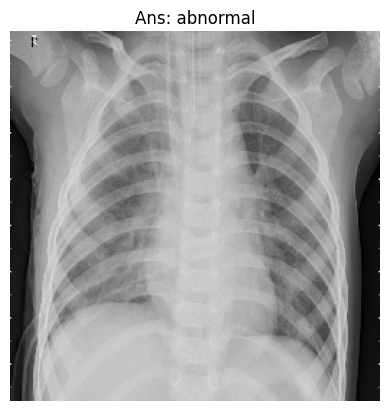

Take # 35 as test image.
This model is 73.08% confident that the scan is abnormal and 26.92% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



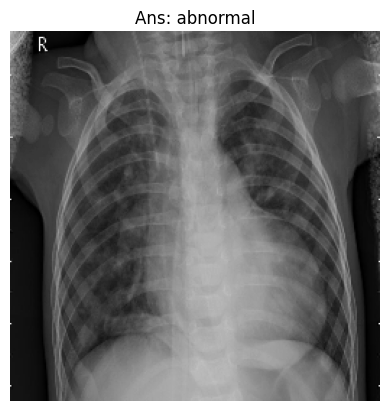

Take # 164 as test image.
This model is 73.06% confident that the scan is abnormal and 26.94% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



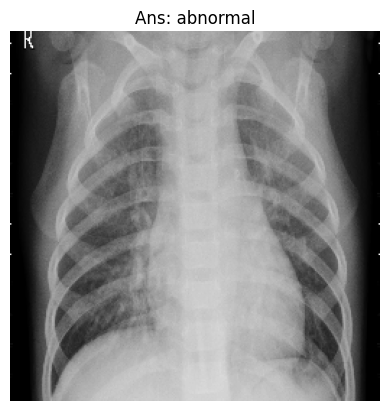

Take # 185 as test image.
This model is 73.04% confident that the scan is abnormal and 26.96% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



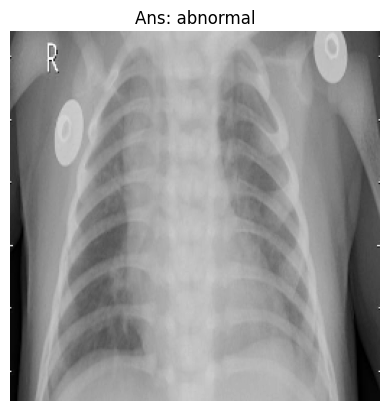

Take # 381 as test image.
This model is 52.89% confident that the scan is abnormal and 47.11% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



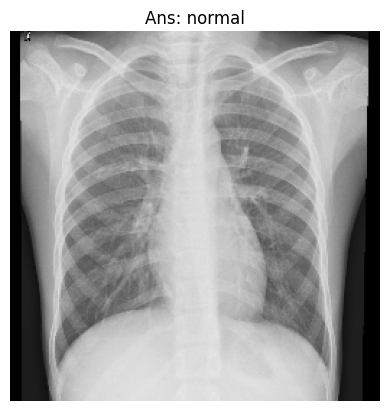

Take # 328 as test image.
This model is 60.03% confident that the scan is abnormal and 39.97% confident that the scan is normal.

Prediction is abnormal.
Incorrect 😢



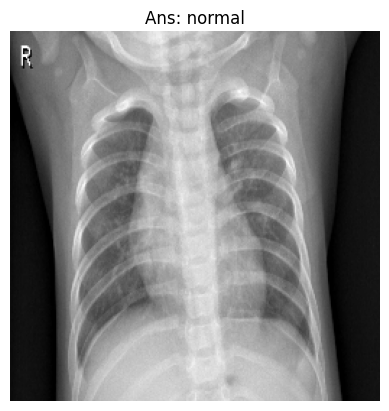

Take # 37 as test image.
This model is 71.07% confident that the scan is abnormal and 28.93% confident that the scan is normal.

Prediction is abnormal.
Correct 😊



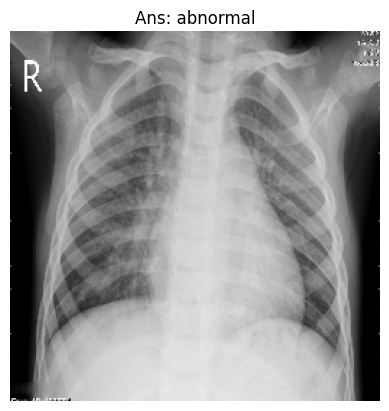

答對 50 個


In [ ]:
import torch.nn as nn
# # Declare the model architecture
# model = nn.Sequential(
#     nn.Flatten(),
#     nn.Linear(256*256*1, 256),
#     nn.ReLU(),
#     nn.Linear(256, 1)#現在用的是binary cross entropy(兩個數log相加)第二個數字為loss用的數字，cross entropy要寫成2，會給兩類的propobility
# ).cuda()#cuda放進GPU裡面

# print(model)

model = nn.Sequential(
    nn.Flatten(),

    nn.Linear(256*256*1, 64),
    nn.BatchNorm1d(64),
    nn.ReLU(),
    nn.Dropout(0.5),

    # nn.Linear(64, 64),
    # nn.BatchNorm1d(64),
    # nn.ReLU(),
    # nn.Dropout(0.5),

    nn.Linear(64, 64),
    nn.BatchNorm1d(64),
    nn.ReLU(),
    nn.Dropout(0.5),

    nn.Linear(64, 1)
).cuda()
# Load the trained weights
# model.load_state_dict(torch.load('model_classification.pth'))
model.load_state_dict(torch.load('model_classification.pth'))
# Set the model to evaluation mode
model.eval()
correct=0
for i in range(100):
  import matplotlib.pyplot as plt
  index = np.random.randint(0, len(x_test))
  print(f'Take # {index} as test image.')

  # Normalize the image just like during training
  test_image = (x_test[index] / 255.0).clone().detach().float().cuda()
  test_image = test_image.unsqueeze(0)  # add batch dimension

  # Model prediction
  with torch.no_grad():
      prediction = model(test_image)
      prediction = torch.sigmoid(prediction)  # Convert logits to probabilities

  class_names = ['normal', 'abnormal']
  confidence = torch.sigmoid(prediction).squeeze().item()

  print(f'This model is {round(100 * confidence, 2)}% confident that the scan is {class_names[1]} and {round(100 * (1 - confidence), 2)}% confident that the scan is {class_names[0]}.')

  predicted_class = class_names[0] if confidence < 0.5 else class_names[1]

  print()
  print(f'Prediction is {predicted_class}.')
  print(f'{"Correct 😊" if predicted_class == class_names[y_test[index].item()] else "Incorrect 😢"}')
  print()
  if predicted_class == class_names[y_test[index].item()]:
    correct=correct+1
  plt.axis('off')
  plt.title(f"Ans: {'abnormal' if y_test[index] else 'normal'}")
  plt.imshow(x_test[index], cmap='gray')  # Assuming the images are grayscale and channel-first
  plt.show()
print("答對",correct,"個")

#Training the Neural Network (CE)

In [ ]:
import torch.nn as nn
#torch.nn.functional
# Model definition
# ce_model = nn.Sequential(
#     nn.Flatten(),
#     nn.Linear(256*256*1, 256),
#     nn.ReLU(),
#     nn.Linear(256, 2)#現在用的是binary cross entropy(兩個數log相加)第二個數字為loss用的數字，cross entropy要寫成2，會給兩類的propobility
# ).cuda()#cuda放進GPU裡面

# print(ce_model)

ce_model = nn.Sequential(
    nn.Flatten(),

    nn.Linear(256*256*1, 64),
    nn.BatchNorm1d(64),
    nn.ReLU(),
    nn.Dropout(0.5),

    nn.Linear(64, 64),
    nn.BatchNorm1d(64),
    nn.ReLU(),
    nn.Dropout(0.5),

    nn.Linear(64, 64),
    nn.BatchNorm1d(64),
    nn.ReLU(),
    nn.Dropout(0.5),

    nn.Linear(64, 2)
).cuda()

print(ce_model)

Sequential(
  (0): Flatten(start_dim=1, end_dim=-1)
  (1): Linear(in_features=65536, out_features=64, bias=True)
  (2): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (3): ReLU()
  (4): Dropout(p=0.5, inplace=False)
  (5): Linear(in_features=64, out_features=64, bias=True)
  (6): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): ReLU()
  (8): Dropout(p=0.5, inplace=False)
  (9): Linear(in_features=64, out_features=64, bias=True)
  (10): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (11): ReLU()
  (12): Dropout(p=0.5, inplace=False)
  (13): Linear(in_features=64, out_features=2, bias=True)
)


In [ ]:
import torch.optim as optim
from torch.optim.lr_scheduler import CosineAnnealingLR

train_losses = []
val_losses = []
train_accuracies = []
val_accuracies = []

epochs = 100
best_val_loss = float('inf')

# Criterion and Optimizer(hyperparameter)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(ce_model.parameters(), lr=1e-3)
lr_scheduler = CosineAnnealingLR(optimizer, T_max=len(train_loader)*epochs, eta_min=0)

for epoch in range(epochs):
    # Training
    ce_model.train()
    total_loss = 0.0
    train_correct = 0
    total_train_samples = 0

    for images, labels in train_loader:
        images = images.cuda()
        images = images / 255.
        labels = labels.cuda()
        optimizer.zero_grad()
        outputs = ce_model(images)
        labels = labels.long()  # Changed from labels.float().unsqueeze(1) for BCE loss
        loss = criterion(outputs, labels)
        loss.backward()#把loss gradient算回來
        optimizer.step()
        total_loss += loss.item()

        # Calculate correct predictions for training data
        train_predicted = outputs.argmax(-1)  # Changed from torch.sigmoid(outputs) > 0.5 for BCE loss
        train_correct += (train_predicted.float() == labels).sum().item()
        total_train_samples += labels.size(0)

    avg_train_loss = total_loss / len(train_loader)
    train_accuracy = 100. * train_correct / total_train_samples

    # Validation
    ce_model.eval()
    total_val_loss = 0.0
    correct = 0
    total = 0
    with torch.no_grad():
        for images, labels in val_loader:
            images = images.cuda()
            images = images / 255.
            labels = labels.cuda()
            outputs = ce_model(images)
            labels_lo = labels.long()  # Changed from labels.float().unsqueeze(1) for BCE loss
            loss = criterion(outputs, labels_lo)
            total_val_loss += loss.item()

            predicted = outputs.argmax(-1)  # Changed from torch.sigmoid(outputs) > 0.5 for BCE loss
            correct += (predicted.float() == labels_lo).sum().item()
            total += labels.size(0)

    avg_val_loss = total_val_loss / len(val_loader)
    val_accuracy = 100. * correct / total

    print(f'Epoch {epoch+1}/{epochs}, Train Loss: {avg_train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%, Val Loss: {avg_val_loss:.4f}, Val Accuracy: {val_accuracy:.2f}%')

    # Learning rate update
    lr_scheduler.step()

    # Checkpoint
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        torch.save(ce_model.state_dict(), 'ce_model_classification.pth')

    # Store performance
    train_losses.append(avg_train_loss)
    train_accuracies.append(train_accuracy)
    val_losses.append(avg_val_loss)
    val_accuracies.append(val_accuracy)

Epoch 1/100, Train Loss: 0.6288, Train Accuracy: 64.62%, Val Loss: 0.4931, Val Accuracy: 81.25%
Epoch 2/100, Train Loss: 0.4479, Train Accuracy: 80.75%, Val Loss: 0.4054, Val Accuracy: 85.25%
Epoch 3/100, Train Loss: 0.2979, Train Accuracy: 88.62%, Val Loss: 0.2366, Val Accuracy: 91.75%
Epoch 4/100, Train Loss: 0.2455, Train Accuracy: 90.75%, Val Loss: 0.2279, Val Accuracy: 91.00%
Epoch 5/100, Train Loss: 0.2086, Train Accuracy: 92.31%, Val Loss: 0.1861, Val Accuracy: 93.50%
Epoch 6/100, Train Loss: 0.1840, Train Accuracy: 92.50%, Val Loss: 0.2916, Val Accuracy: 88.25%
Epoch 7/100, Train Loss: 0.1588, Train Accuracy: 94.62%, Val Loss: 0.2210, Val Accuracy: 91.50%
Epoch 8/100, Train Loss: 0.1471, Train Accuracy: 94.19%, Val Loss: 0.1752, Val Accuracy: 94.25%
Epoch 9/100, Train Loss: 0.1443, Train Accuracy: 95.38%, Val Loss: 0.2647, Val Accuracy: 91.25%
Epoch 10/100, Train Loss: 0.1466, Train Accuracy: 94.56%, Val Loss: 0.2112, Val Accuracy: 91.50%
Epoch 11/100, Train Loss: 0.1127, Train

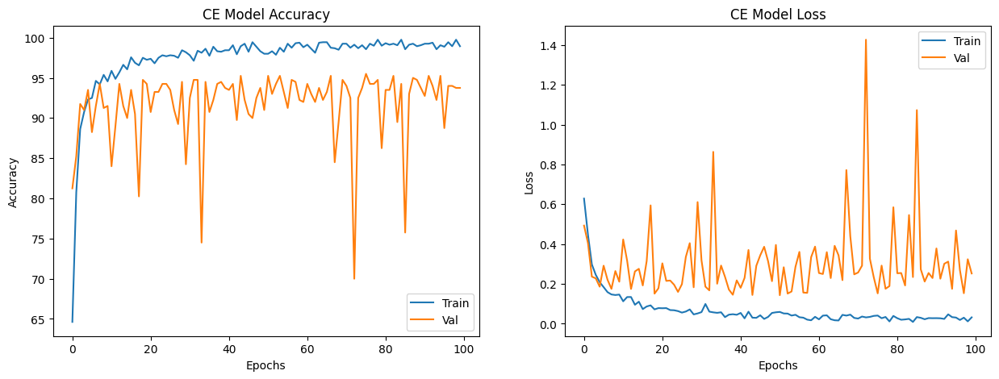

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 2, figsize=(15, 5))

# Plotting training and validation accuracy
ax[0].plot(train_accuracies)
ax[0].plot(val_accuracies)
ax[0].set_title("CE Model Accuracy")
ax[0].set_xlabel("Epochs")
ax[0].set_ylabel("Accuracy")
ax[0].legend(["Train", "Val"])

# Plotting training and validation loss
ax[1].plot(train_losses)
ax[1].plot(val_losses)
ax[1].set_title("CE Model Loss")
ax[1].set_xlabel("Epochs")
ax[1].set_ylabel("Loss")
ax[1].legend(["Train", "Val"])

plt.show()

Take # 59 as a test image.
This ce_model is 0.01% confident that the scan is normal.
This ce_model is 99.99% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



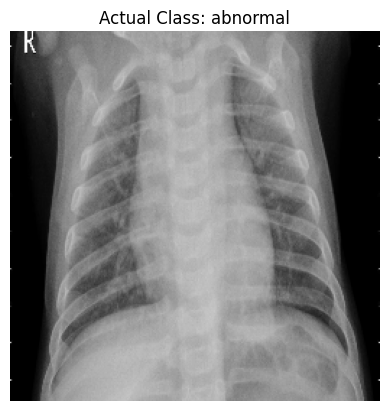

Take # 124 as a test image.
This ce_model is 0.11% confident that the scan is normal.
This ce_model is 99.89% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



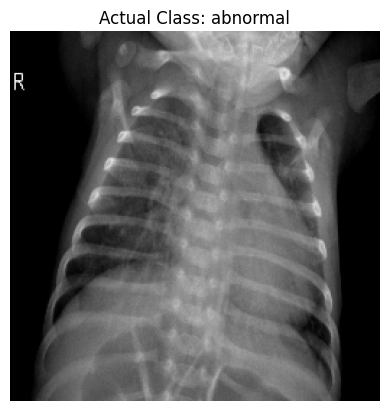

Take # 145 as a test image.
This ce_model is 0.01% confident that the scan is normal.
This ce_model is 99.99% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



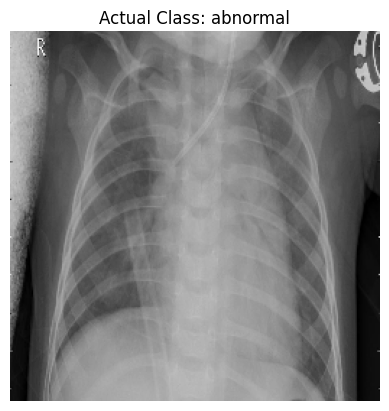

Take # 348 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



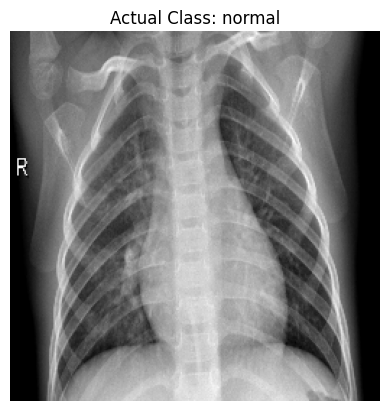

Take # 36 as a test image.
This ce_model is 0.02% confident that the scan is normal.
This ce_model is 99.98% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



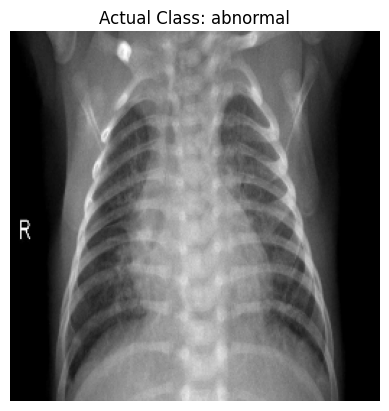

Take # 322 as a test image.
This ce_model is 98.85% confident that the scan is normal.
This ce_model is 1.15% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



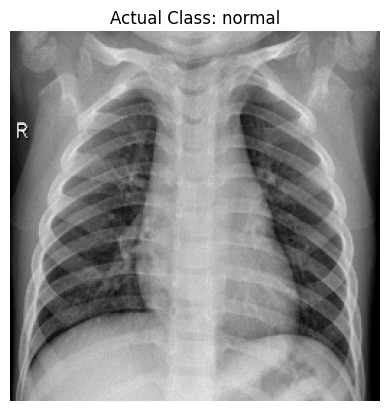

Take # 319 as a test image.
This ce_model is 79.43% confident that the scan is normal.
This ce_model is 20.57% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



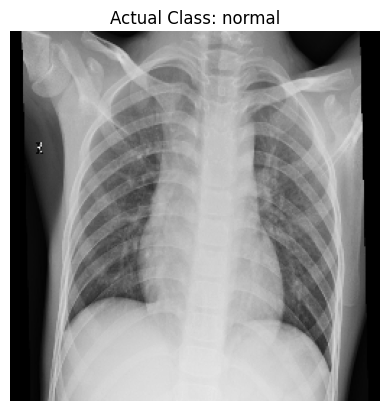

Take # 143 as a test image.
This ce_model is 0.16% confident that the scan is normal.
This ce_model is 99.84% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



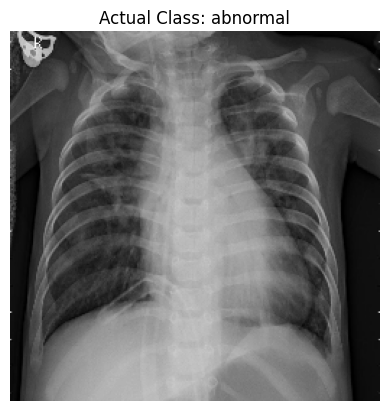

Take # 360 as a test image.
This ce_model is 81.02% confident that the scan is normal.
This ce_model is 18.98% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



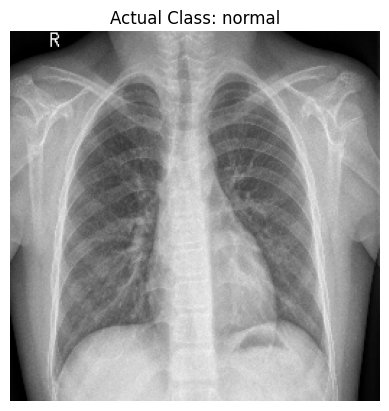

Take # 350 as a test image.
This ce_model is 0.1% confident that the scan is normal.
This ce_model is 99.9% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



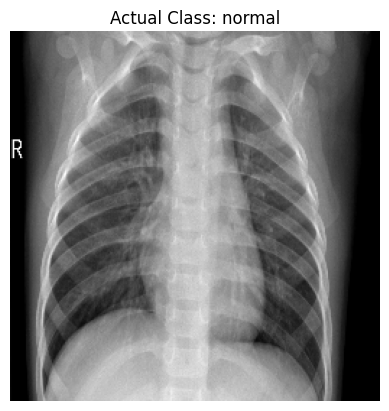

Take # 78 as a test image.
This ce_model is 0.11% confident that the scan is normal.
This ce_model is 99.89% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



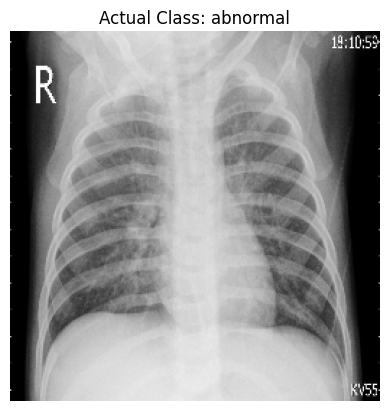

Take # 223 as a test image.
This ce_model is 95.4% confident that the scan is normal.
This ce_model is 4.6% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



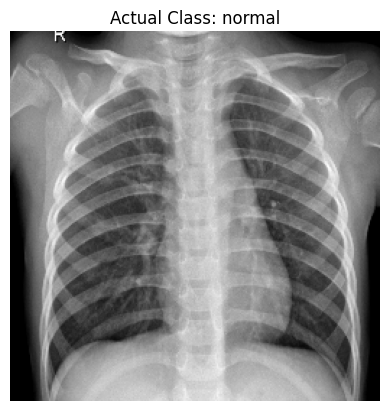

Take # 10 as a test image.
This ce_model is 0.15% confident that the scan is normal.
This ce_model is 99.85% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



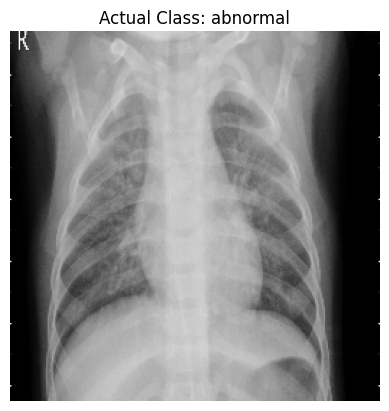

Take # 316 as a test image.
This ce_model is 2.57% confident that the scan is normal.
This ce_model is 97.43% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



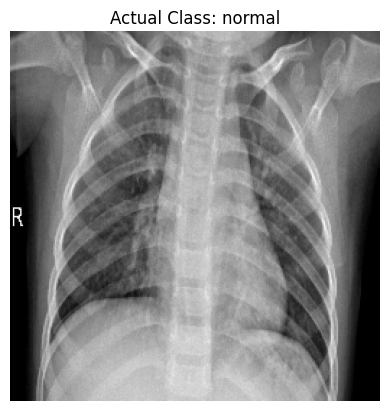

Take # 3 as a test image.
This ce_model is 0.01% confident that the scan is normal.
This ce_model is 99.99% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



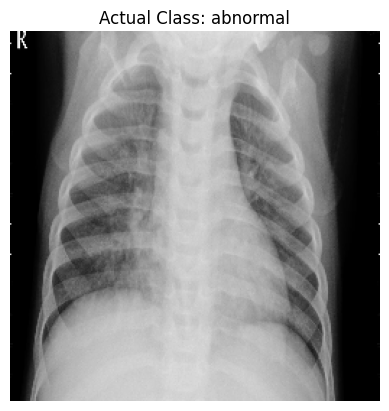

Take # 316 as a test image.
This ce_model is 2.57% confident that the scan is normal.
This ce_model is 97.43% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



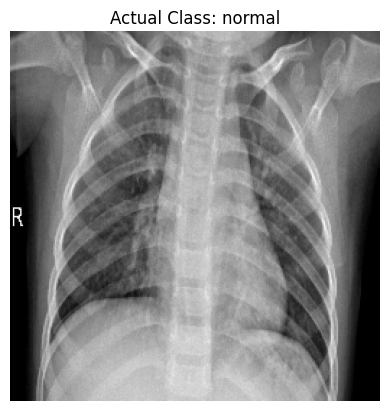

Take # 79 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



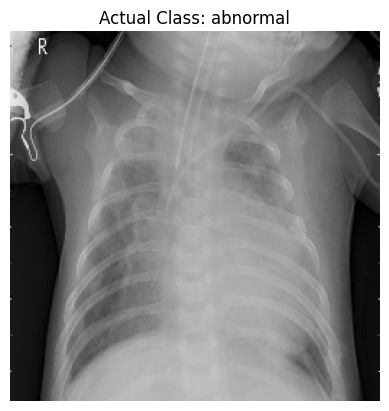

Take # 102 as a test image.
This ce_model is 0.01% confident that the scan is normal.
This ce_model is 99.99% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



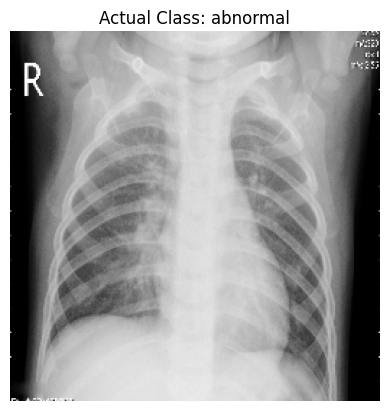

Take # 207 as a test image.
This ce_model is 31.4% confident that the scan is normal.
This ce_model is 68.6% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



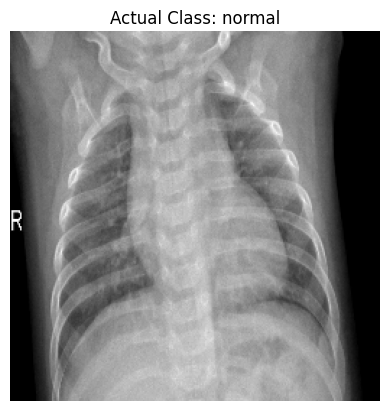

Take # 63 as a test image.
This ce_model is 2.76% confident that the scan is normal.
This ce_model is 97.24% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



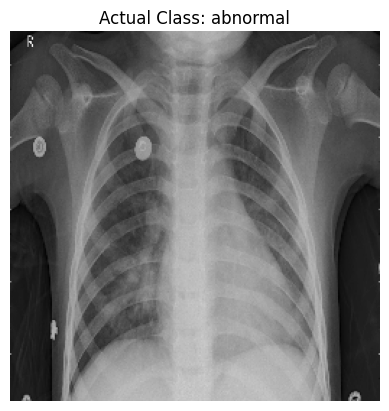

Take # 86 as a test image.
This ce_model is 0.01% confident that the scan is normal.
This ce_model is 99.99% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



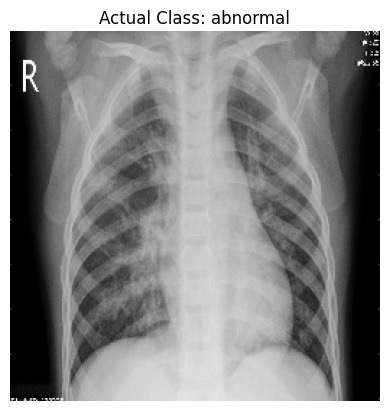

Take # 276 as a test image.
This ce_model is 93.0% confident that the scan is normal.
This ce_model is 7.0% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



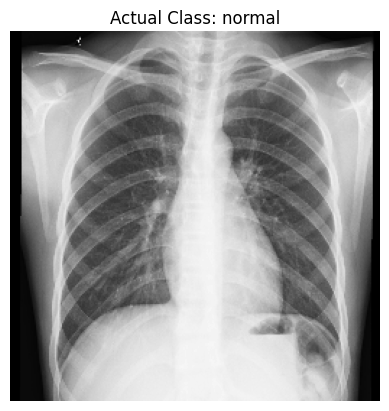

Take # 113 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



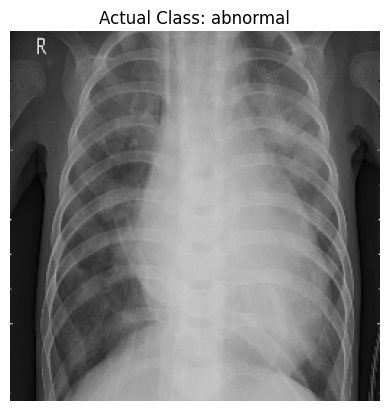

Take # 72 as a test image.
This ce_model is 0.05% confident that the scan is normal.
This ce_model is 99.95% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



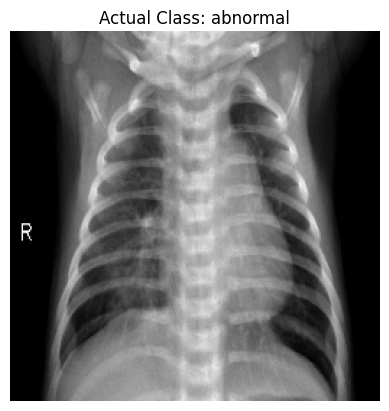

Take # 308 as a test image.
This ce_model is 100.0% confident that the scan is normal.
This ce_model is 0.0% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



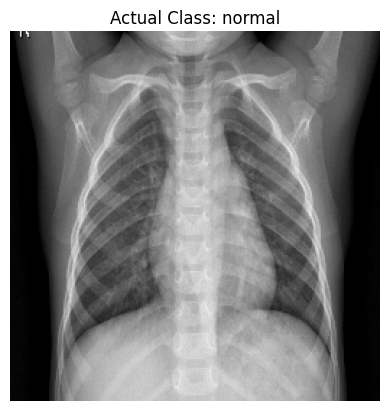

Take # 273 as a test image.
This ce_model is 80.31% confident that the scan is normal.
This ce_model is 19.69% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



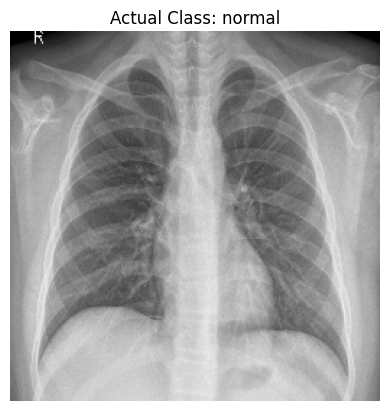

Take # 377 as a test image.
This ce_model is 68.66% confident that the scan is normal.
This ce_model is 31.34% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



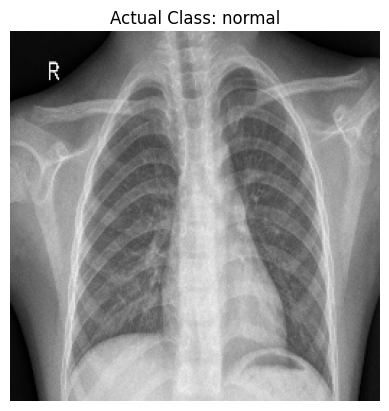

Take # 333 as a test image.
This ce_model is 90.81% confident that the scan is normal.
This ce_model is 9.19% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



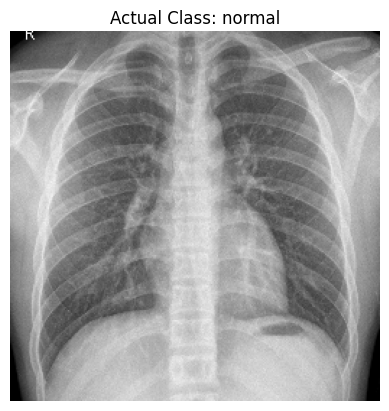

Take # 248 as a test image.
This ce_model is 0.06% confident that the scan is normal.
This ce_model is 99.94% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



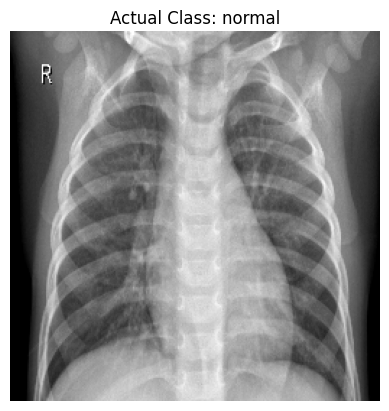

Take # 363 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



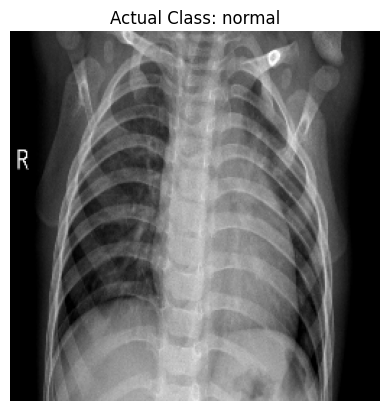

Take # 371 as a test image.
This ce_model is 99.98% confident that the scan is normal.
This ce_model is 0.02% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



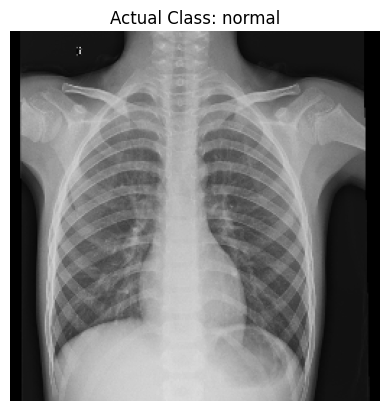

Take # 358 as a test image.
This ce_model is 0.01% confident that the scan is normal.
This ce_model is 99.99% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



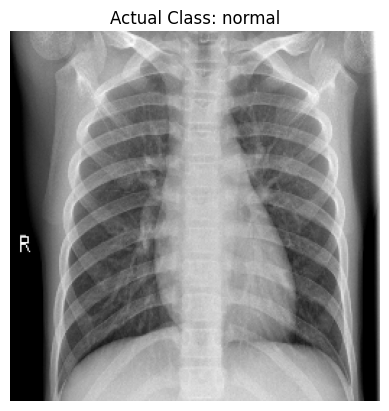

Take # 75 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



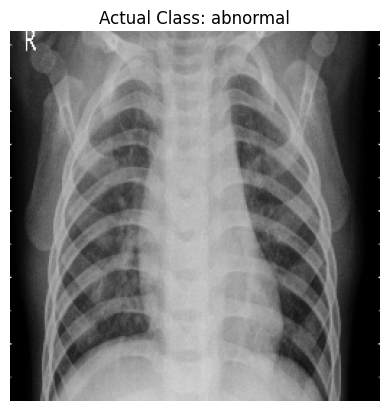

Take # 152 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



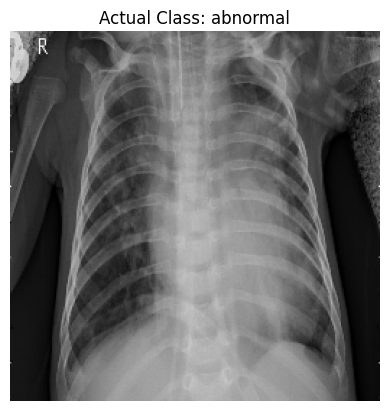

Take # 246 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



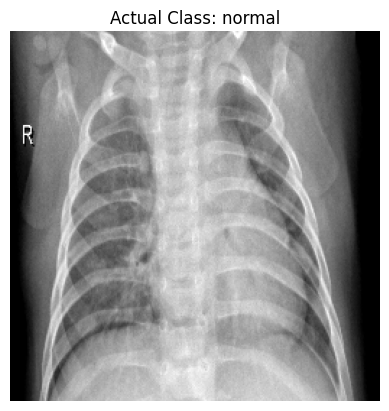

Take # 165 as a test image.
This ce_model is 0.02% confident that the scan is normal.
This ce_model is 99.98% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



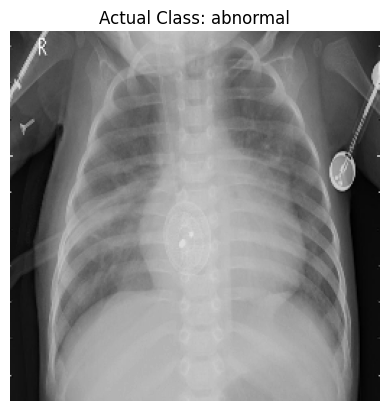

Take # 335 as a test image.
This ce_model is 0.01% confident that the scan is normal.
This ce_model is 99.99% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



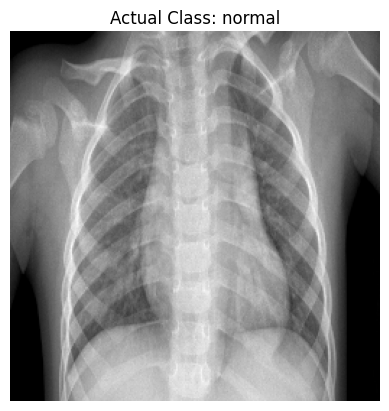

Take # 159 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



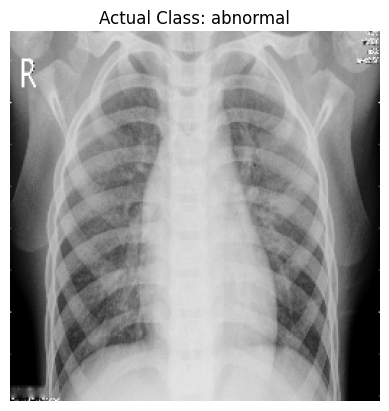

Take # 21 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



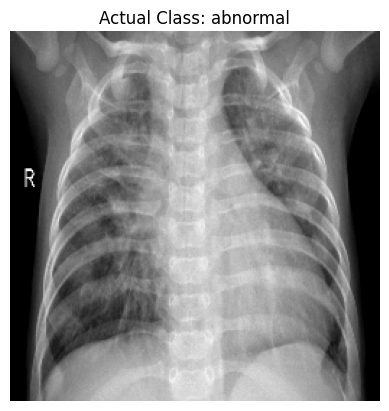

Take # 293 as a test image.
This ce_model is 10.87% confident that the scan is normal.
This ce_model is 89.13% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



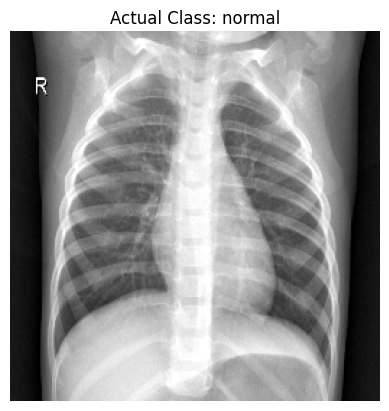

Take # 274 as a test image.
This ce_model is 100.0% confident that the scan is normal.
This ce_model is 0.0% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



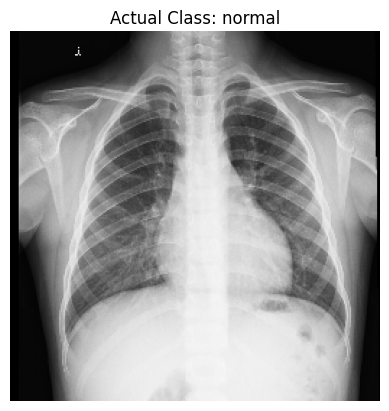

Take # 84 as a test image.
This ce_model is 0.35% confident that the scan is normal.
This ce_model is 99.65% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



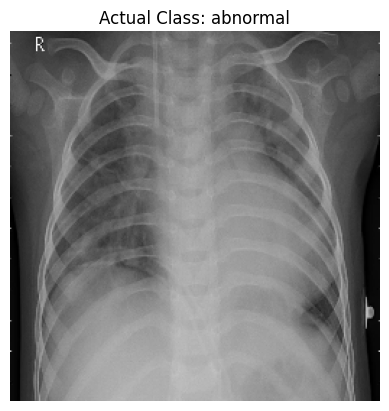

Take # 370 as a test image.
This ce_model is 93.6% confident that the scan is normal.
This ce_model is 6.4% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



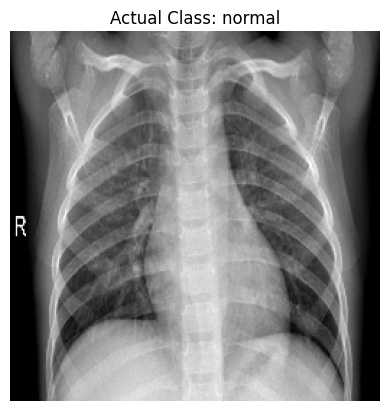

Take # 88 as a test image.
This ce_model is 0.05% confident that the scan is normal.
This ce_model is 99.95% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



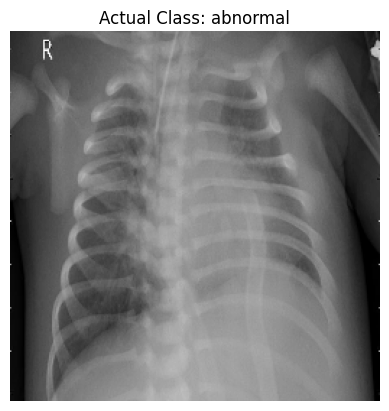

Take # 196 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



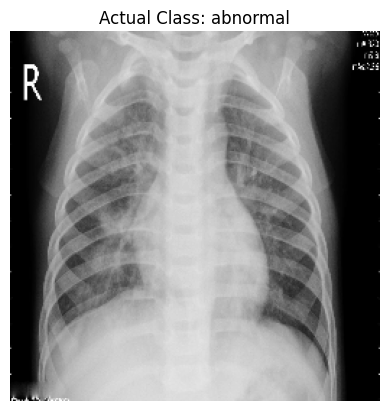

Take # 107 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



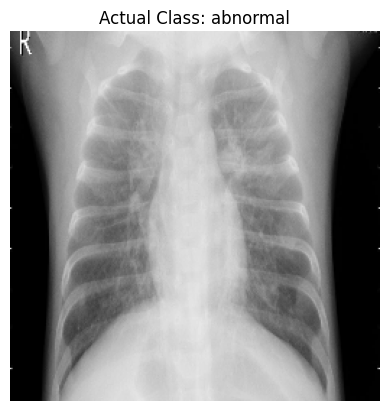

Take # 1 as a test image.
This ce_model is 0.07% confident that the scan is normal.
This ce_model is 99.93% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



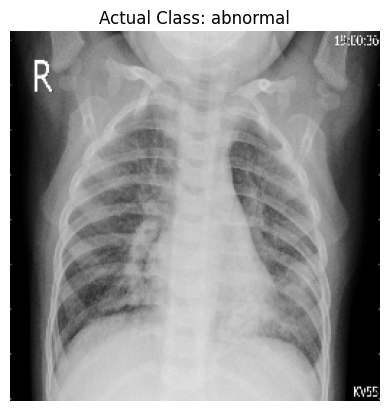

Take # 128 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



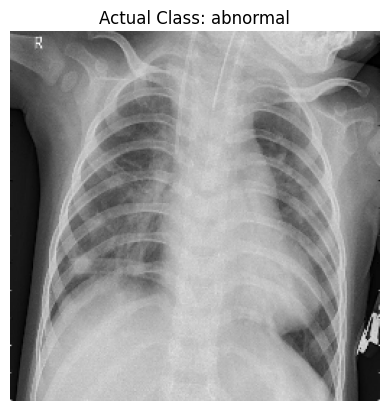

Take # 325 as a test image.
This ce_model is 95.82% confident that the scan is normal.
This ce_model is 4.18% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



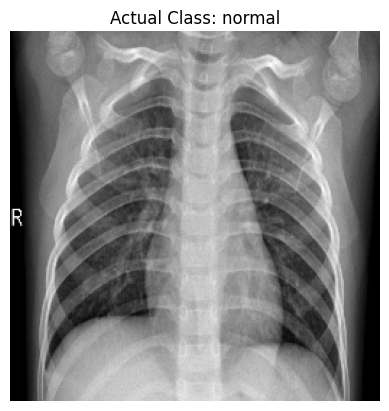

Take # 55 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



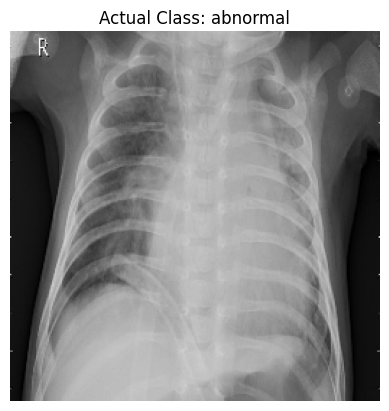

Take # 210 as a test image.
This ce_model is 68.92% confident that the scan is normal.
This ce_model is 31.08% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



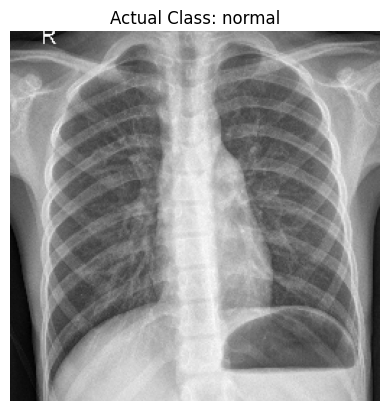

Take # 188 as a test image.
This ce_model is 0.03% confident that the scan is normal.
This ce_model is 99.97% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



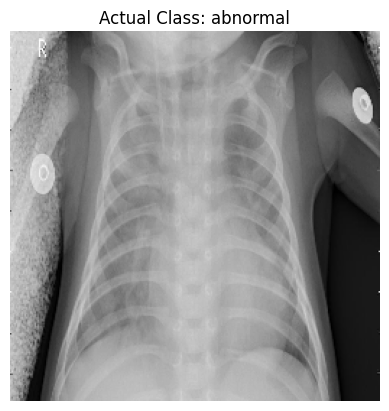

Take # 86 as a test image.
This ce_model is 0.01% confident that the scan is normal.
This ce_model is 99.99% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



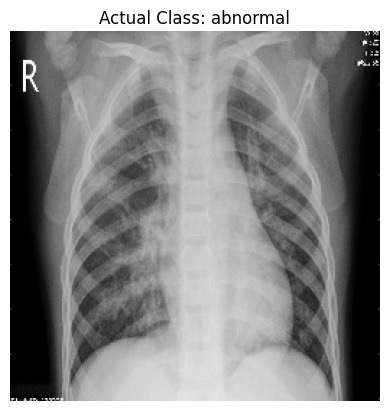

Take # 199 as a test image.
This ce_model is 0.02% confident that the scan is normal.
This ce_model is 99.98% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



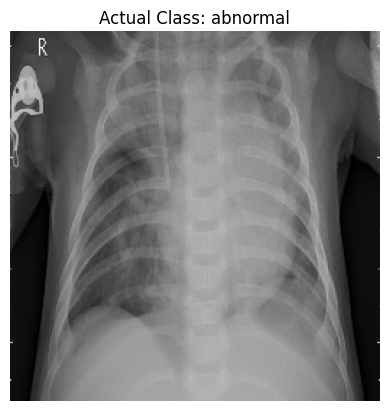

Take # 265 as a test image.
This ce_model is 96.15% confident that the scan is normal.
This ce_model is 3.85% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



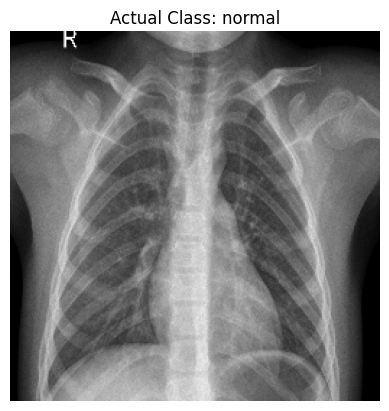

Take # 239 as a test image.
This ce_model is 31.67% confident that the scan is normal.
This ce_model is 68.33% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



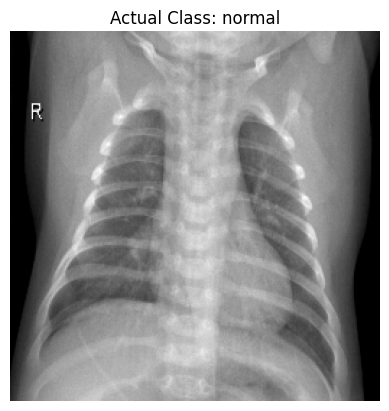

Take # 192 as a test image.
This ce_model is 0.25% confident that the scan is normal.
This ce_model is 99.75% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



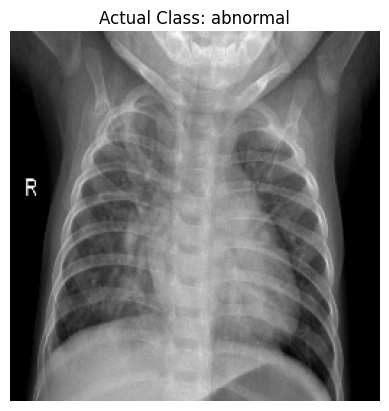

Take # 144 as a test image.
This ce_model is 0.35% confident that the scan is normal.
This ce_model is 99.65% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



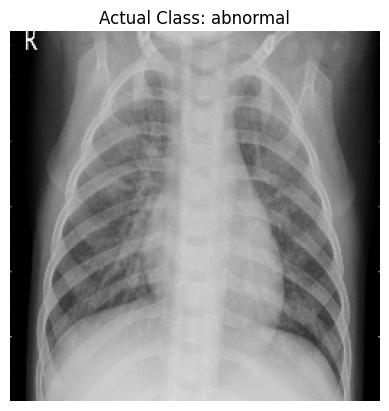

Take # 155 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



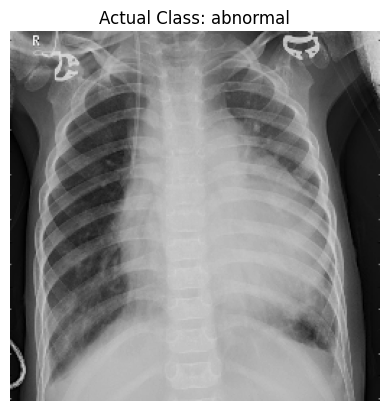

Take # 237 as a test image.
This ce_model is 1.82% confident that the scan is normal.
This ce_model is 98.18% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



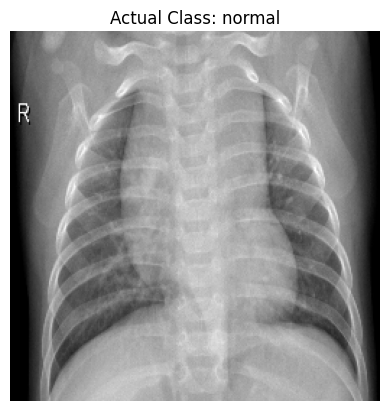

Take # 243 as a test image.
This ce_model is 0.64% confident that the scan is normal.
This ce_model is 99.36% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



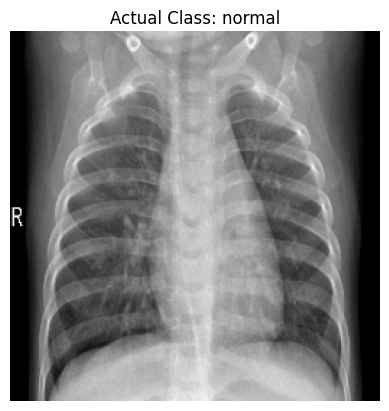

Take # 174 as a test image.
This ce_model is 0.02% confident that the scan is normal.
This ce_model is 99.98% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



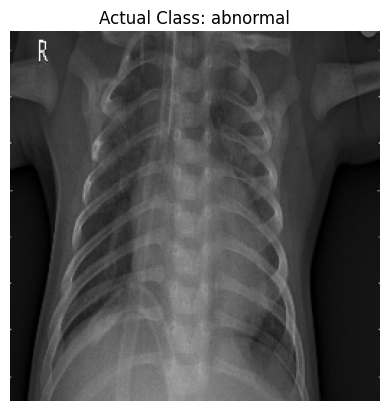

Take # 200 as a test image.
This ce_model is 4.44% confident that the scan is normal.
This ce_model is 95.56% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



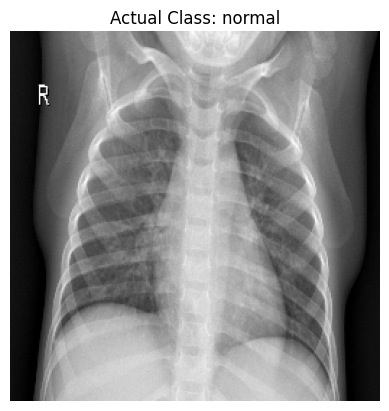

Take # 303 as a test image.
This ce_model is 0.17% confident that the scan is normal.
This ce_model is 99.83% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



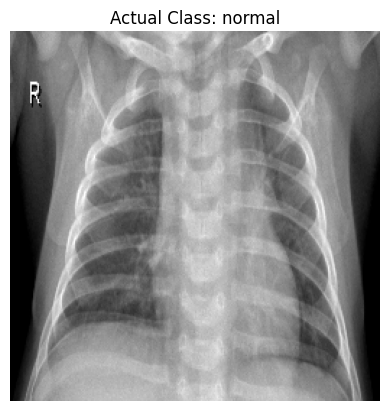

Take # 142 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



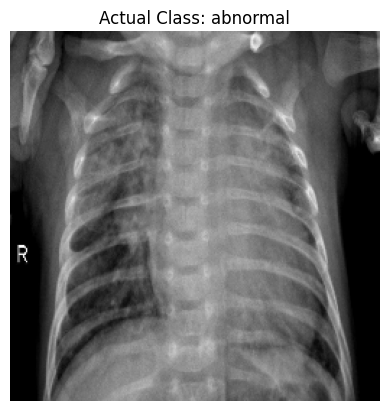

Take # 70 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



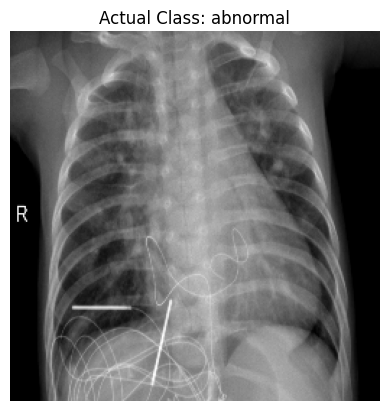

Take # 310 as a test image.
This ce_model is 1.1% confident that the scan is normal.
This ce_model is 98.9% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



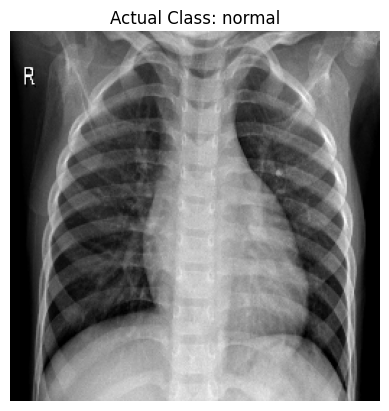

Take # 42 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



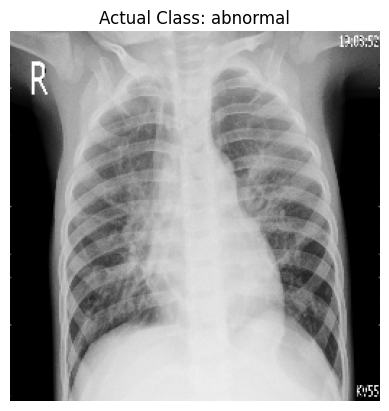

Take # 330 as a test image.
This ce_model is 99.13% confident that the scan is normal.
This ce_model is 0.87% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



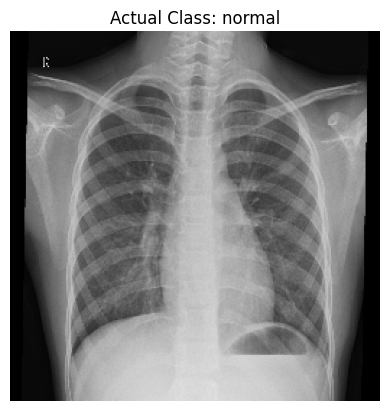

Take # 279 as a test image.
This ce_model is 88.25% confident that the scan is normal.
This ce_model is 11.75% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



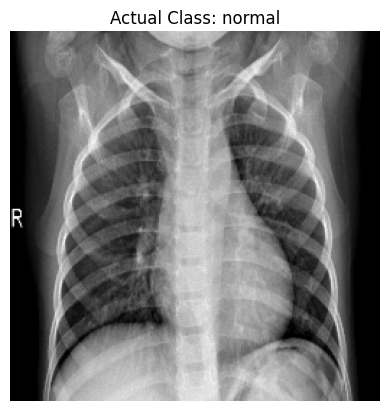

Take # 154 as a test image.
This ce_model is 0.11% confident that the scan is normal.
This ce_model is 99.89% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



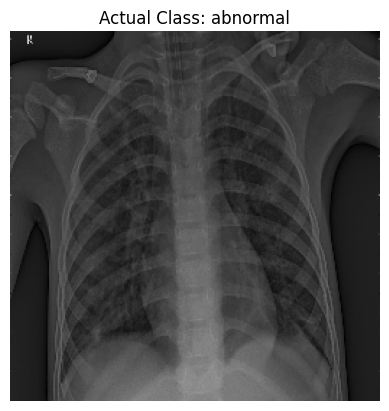

Take # 163 as a test image.
This ce_model is 80.49% confident that the scan is normal.
This ce_model is 19.51% confident that the scan is abnormal.

Prediction is normal.
Actual class is abnormal.
Incorrect 😢



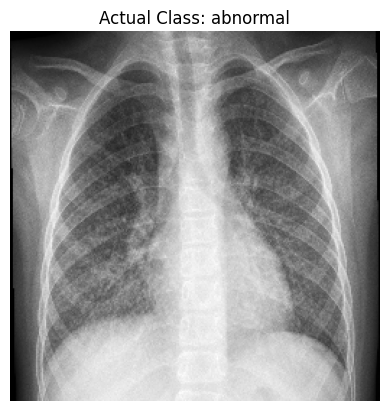

Take # 220 as a test image.
This ce_model is 0.04% confident that the scan is normal.
This ce_model is 99.96% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



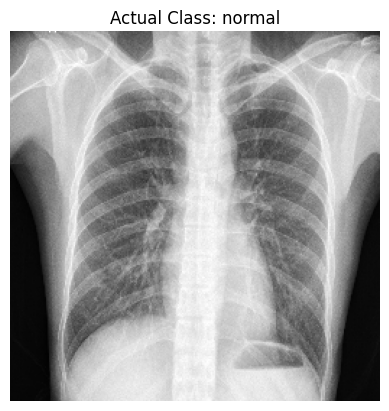

Take # 39 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



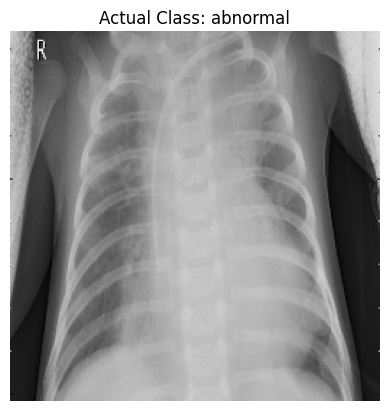

Take # 200 as a test image.
This ce_model is 4.44% confident that the scan is normal.
This ce_model is 95.56% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



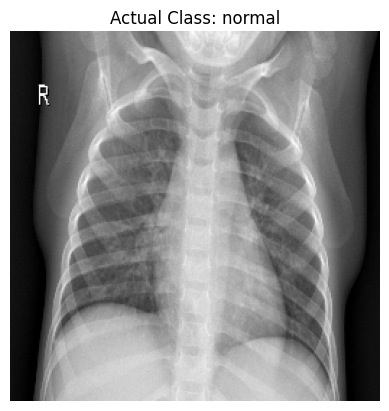

Take # 163 as a test image.
This ce_model is 80.49% confident that the scan is normal.
This ce_model is 19.51% confident that the scan is abnormal.

Prediction is normal.
Actual class is abnormal.
Incorrect 😢



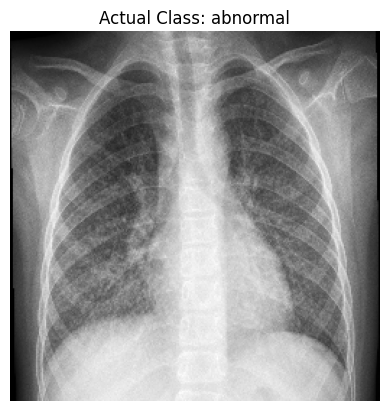

Take # 250 as a test image.
This ce_model is 9.35% confident that the scan is normal.
This ce_model is 90.65% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



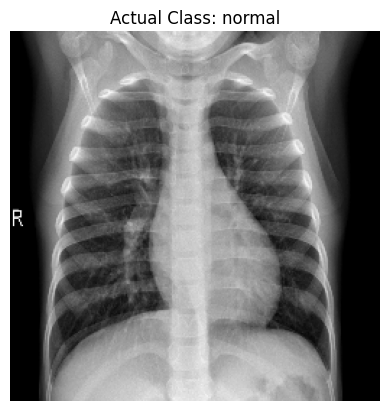

Take # 217 as a test image.
This ce_model is 100.0% confident that the scan is normal.
This ce_model is 0.0% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



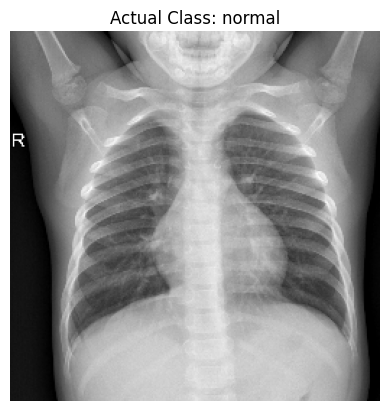

Take # 315 as a test image.
This ce_model is 1.53% confident that the scan is normal.
This ce_model is 98.47% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



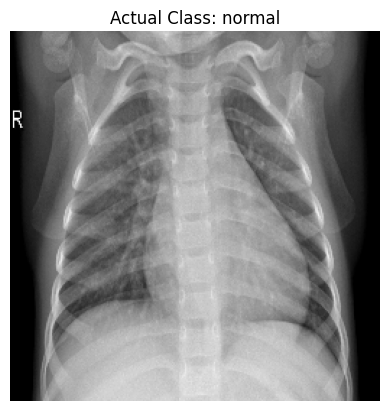

Take # 141 as a test image.
This ce_model is 67.37% confident that the scan is normal.
This ce_model is 32.63% confident that the scan is abnormal.

Prediction is normal.
Actual class is abnormal.
Incorrect 😢



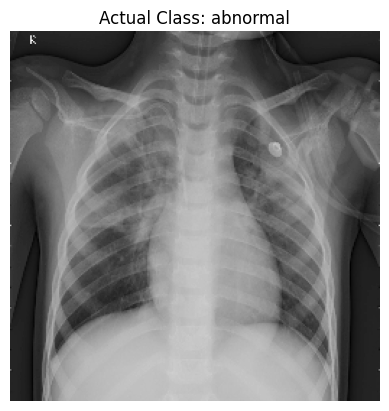

Take # 309 as a test image.
This ce_model is 0.0% confident that the scan is normal.
This ce_model is 100.0% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



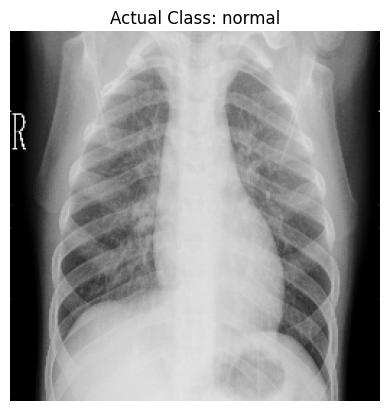

Take # 218 as a test image.
This ce_model is 0.32% confident that the scan is normal.
This ce_model is 99.68% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



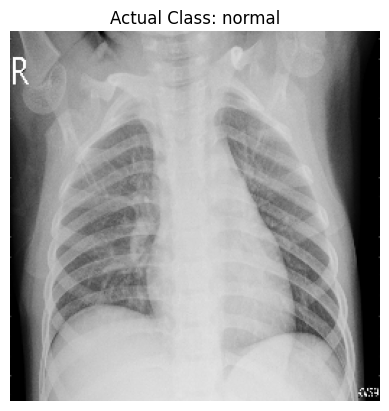

Take # 296 as a test image.
This ce_model is 99.89% confident that the scan is normal.
This ce_model is 0.11% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



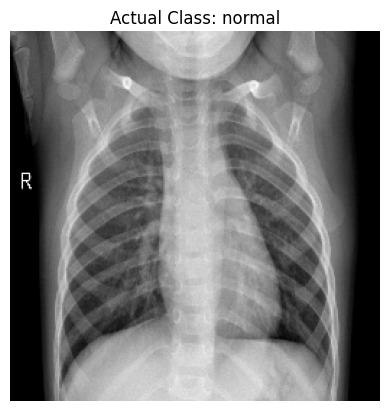

Take # 344 as a test image.
This ce_model is 29.22% confident that the scan is normal.
This ce_model is 70.78% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



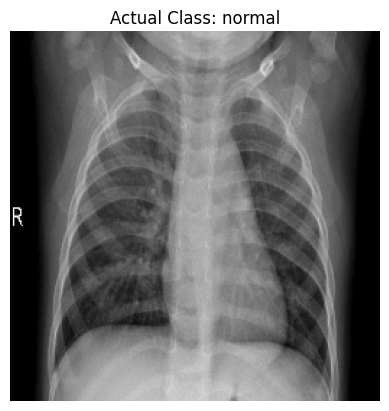

Take # 334 as a test image.
This ce_model is 97.13% confident that the scan is normal.
This ce_model is 2.87% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



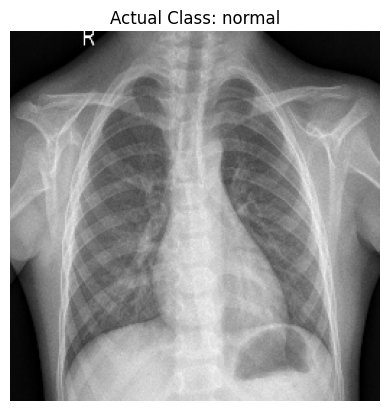

Take # 316 as a test image.
This ce_model is 2.57% confident that the scan is normal.
This ce_model is 97.43% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



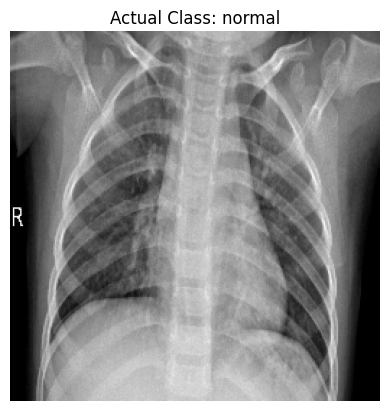

Take # 97 as a test image.
This ce_model is 0.25% confident that the scan is normal.
This ce_model is 99.75% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



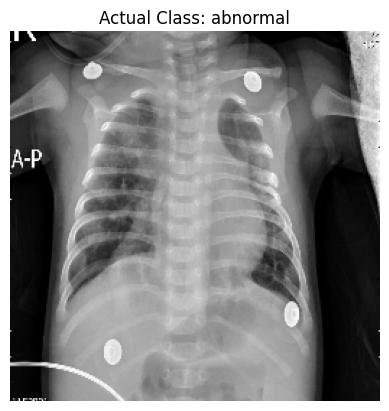

Take # 174 as a test image.
This ce_model is 0.02% confident that the scan is normal.
This ce_model is 99.98% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



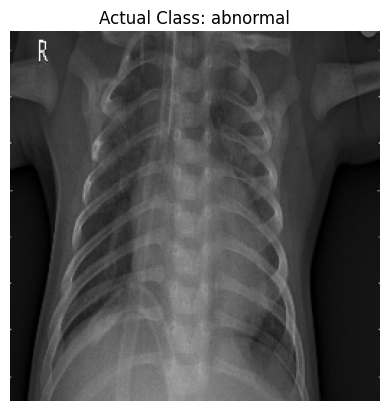

Take # 316 as a test image.
This ce_model is 2.57% confident that the scan is normal.
This ce_model is 97.43% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



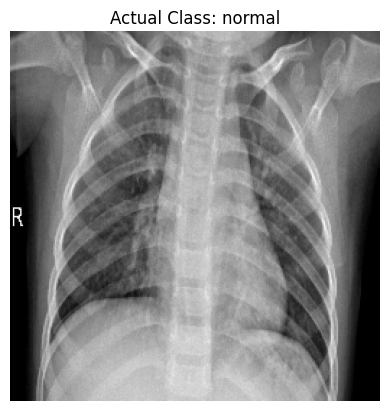

Take # 76 as a test image.
This ce_model is 0.1% confident that the scan is normal.
This ce_model is 99.9% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



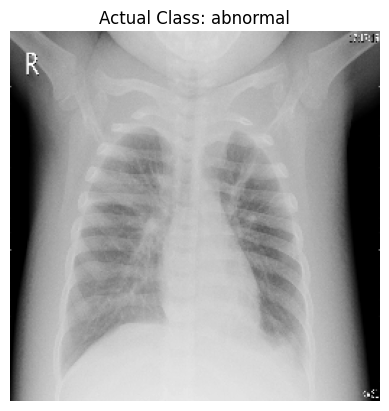

Take # 165 as a test image.
This ce_model is 0.02% confident that the scan is normal.
This ce_model is 99.98% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



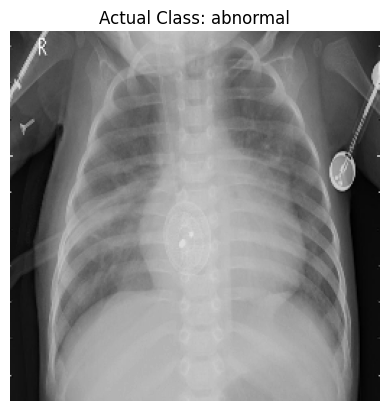

Take # 354 as a test image.
This ce_model is 0.1% confident that the scan is normal.
This ce_model is 99.9% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



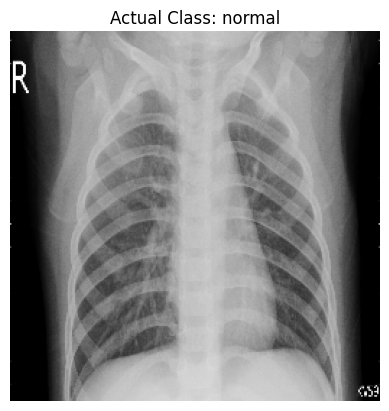

Take # 310 as a test image.
This ce_model is 1.1% confident that the scan is normal.
This ce_model is 98.9% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



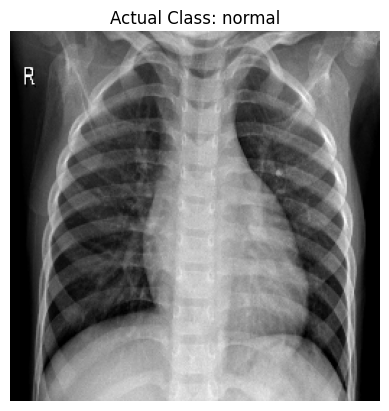

Take # 335 as a test image.
This ce_model is 0.01% confident that the scan is normal.
This ce_model is 99.99% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



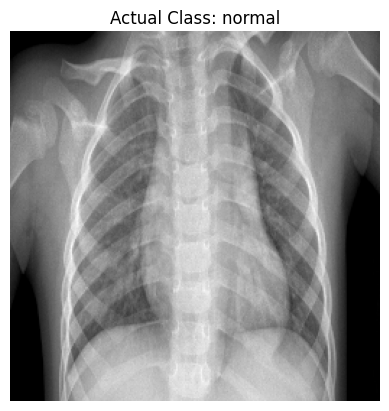

Take # 163 as a test image.
This ce_model is 80.49% confident that the scan is normal.
This ce_model is 19.51% confident that the scan is abnormal.

Prediction is normal.
Actual class is abnormal.
Incorrect 😢



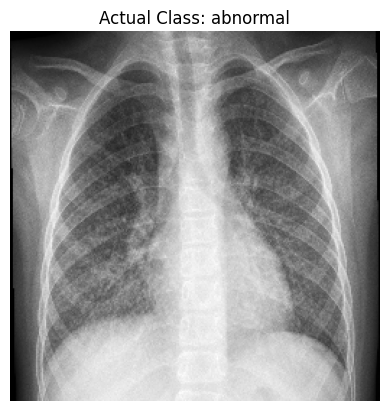

Take # 377 as a test image.
This ce_model is 68.66% confident that the scan is normal.
This ce_model is 31.34% confident that the scan is abnormal.

Prediction is normal.
Actual class is normal.
Correct 😊



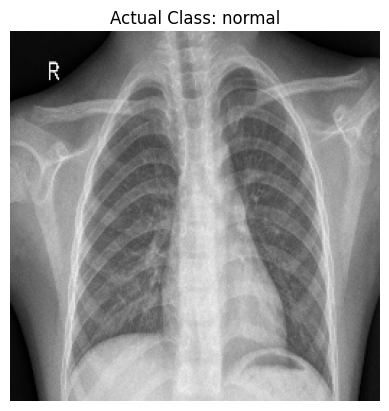

Take # 251 as a test image.
This ce_model is 16.33% confident that the scan is normal.
This ce_model is 83.67% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



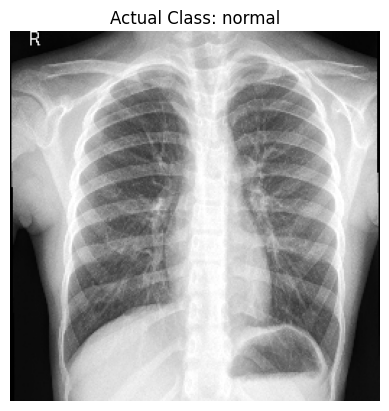

Take # 293 as a test image.
This ce_model is 10.87% confident that the scan is normal.
This ce_model is 89.13% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is normal.
Incorrect 😢



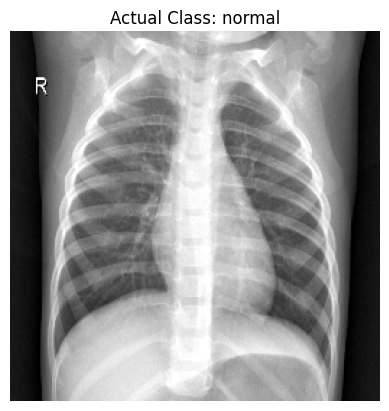

Take # 193 as a test image.
This ce_model is 1.89% confident that the scan is normal.
This ce_model is 98.11% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



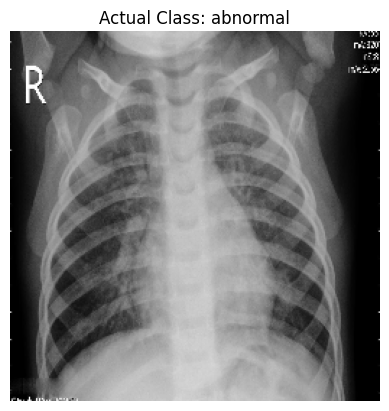

Take # 7 as a test image.
This ce_model is 0.02% confident that the scan is normal.
This ce_model is 99.98% confident that the scan is abnormal.

Prediction is abnormal.
Actual class is abnormal.
Correct 😊



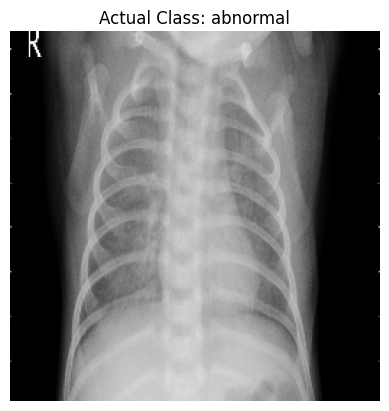

答對 65 個


In [ ]:
import torch.nn as nn
# Declare the model architecture
ce_model = nn.Sequential(
    nn.Flatten(),

    nn.Linear(256*256*1, 64),
    nn.BatchNorm1d(64),
    nn.ReLU(),
    nn.Dropout(0.5),

    nn.Linear(64, 64),
    nn.BatchNorm1d(64),
    nn.ReLU(),
    nn.Dropout(0.5),

    nn.Linear(64, 64),
    nn.BatchNorm1d(64),
    nn.ReLU(),
    nn.Dropout(0.5),

    nn.Linear(64, 2)
).cuda()
ce_model.load_state_dict(torch.load('ce_model_classification.pth'))
# Set the model to evaluation mode
ce_model.eval()
import matplotlib.pyplot as plt
import numpy as np
correct=0
for i in range(100):
  # 1. 隨機選擇一個測試圖像的索引
  index = np.random.randint(0, len(x_test))
  print(f'Take # {index} as a test image.')

  # 2. 正規化測試圖像，準備輸入到模型中
  # Normalize the image just like during training
  test_image = (x_test[index] / 255.0).clone().detach().float().cuda()
  test_image = test_image.unsqueeze(0)  # add batch dimension


  # 3. 模型預測
  with torch.no_grad():
      prediction = ce_model(test_image)

  # 4. 將模型的輸出轉換為類別概率分佈
  class_probabilities = torch.softmax(prediction, dim=1).cpu().numpy()

  class_names = ['normal', 'abnormal']

  # 5. 輸出類別概率
  for i, class_name in enumerate(class_names):
      confidence = class_probabilities[0, i]  # 取得指定類別的概率
      print(f'This ce_model is {round(100 * confidence, 2)}% confident that the scan is {class_name}.')

  # 6. 選擇預測的類別
  predicted_class = class_names[np.argmax(class_probabilities)]

  # 7. 判斷預測是否正確
  true_class = class_names[y_test[index]]
  prediction_status = "Correct 😊" if predicted_class == true_class else "Incorrect 😢"
  if predicted_class == true_class:
    correct=correct+1
  print(f'\nPrediction is {predicted_class}.')
  print(f'Actual class is {true_class}.')
  print(f'{prediction_status}\n')

  plt.axis('off')
  plt.title(f"Actual Class: {true_class}")
  plt.imshow(x_test[index].squeeze(), cmap='gray')
  plt.show()
print("答對",correct,"個")